Importing Packages

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 6.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp39-cp39-linux_x86_64.whl size=44089 sha256=34c1fa338c5a0805b0e09568bf97533aa76bf5f869e204928be3ba14ee3bb8a9
  Stored in directory: /root/.cache/pip/wheels/68/be/8f/b6c454cd264e0b349b47f8ee00755511f277618af9e5dae20d
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flax 0.6.8 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatible.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.

No CUDA runtime is found, using CUDA_HOME='/usr/local/cuda'


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 45.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 17.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any.whl size=61429 sha256=6cab0467d4d8e8209694c61ebd07f443218767b9eed3981011a675728b77ab58
  Stored in directory: /root/.cache/pip/wheels/83/42/02/66178d16e5c44dc26d309931834956baeda371956e86fbd876
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144573 sha256=cb4fadb9b07c1d4b05a6f0c2617db5

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2 import model_zoo

import cv2
import numpy
import matplotlib.pyplot as plt
from pprint import pprint

from google.colab.patches import cv2_imshow

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


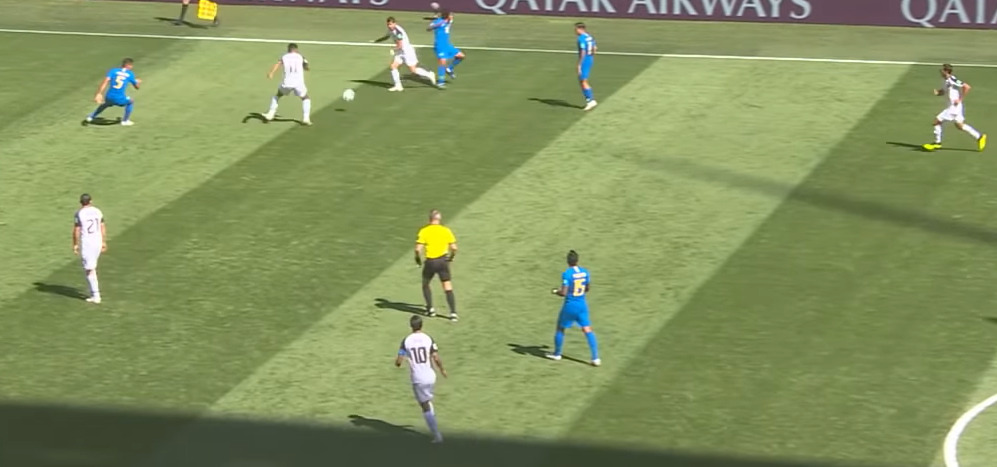

In [ ]:
image = cv2.imread('/content/drive/MyDrive/Football_Data/001.jpeg')
cv2_imshow(image)

In [ ]:
cfg = get_cfg()
cfg.MODEL.DEVICE = "cpu"

cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")

Panoptic And Instance Segmentation functions

model_final_cafdb1.pkl: 261MB [00:02, 97.3MB/s]                          
/usr/local/lib/python3.9/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


panoptic segmentations


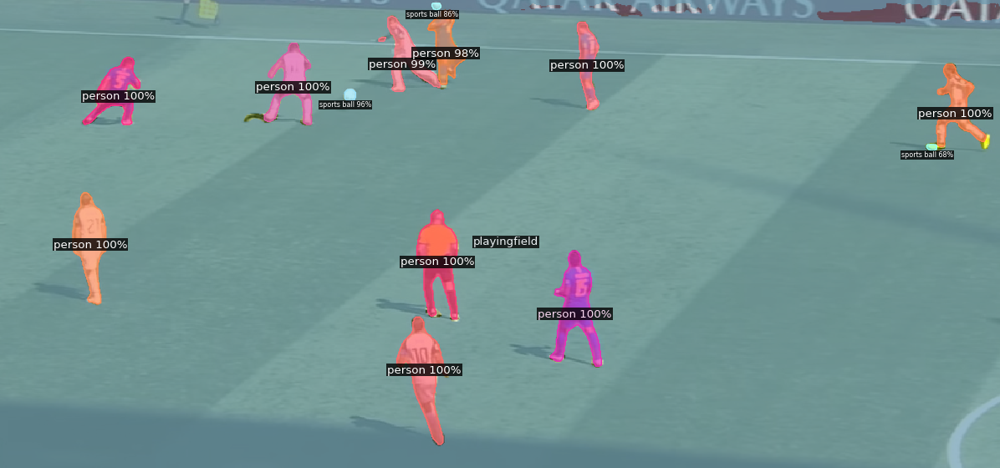

instance predictions


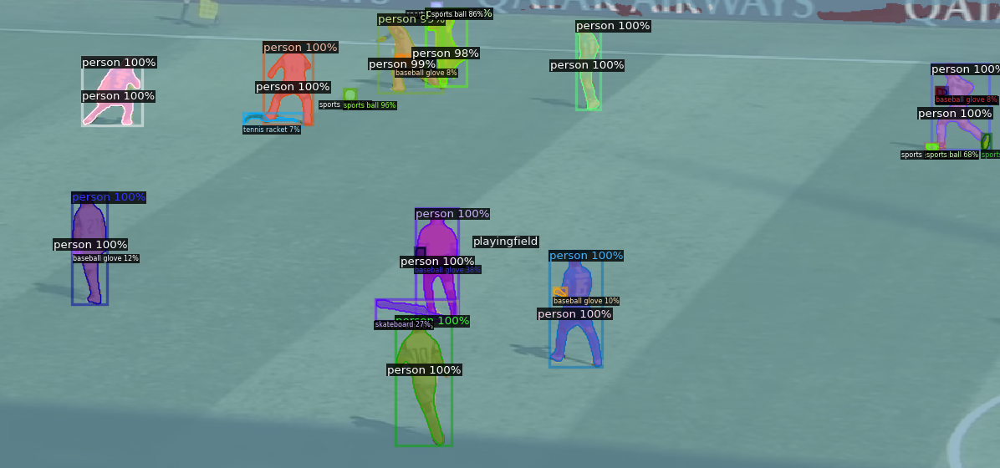

(tensor([[14, 14, 14,  ..., 14, 14, 14],
         [14, 14, 14,  ..., 14, 14, 14],
         [14, 14, 14,  ..., 14, 14, 14],
         ...,
         [14, 14, 14,  ..., 14, 14, 14],
         [14, 14, 14,  ..., 14, 14, 14],
         [14, 14, 14,  ..., 14, 14, 14]], dtype=torch.int32),
 [{'id': 1,
   'isthing': True,
   'score': 0.9993370175361633,
   'category_id': 0,
   'instance_id': 0,
   'area': 2301.0},
  {'id': 2,
   'isthing': True,
   'score': 0.9990419745445251,
   'category_id': 0,
   'instance_id': 1,
   'area': 2728.0},
  {'id': 3,
   'isthing': True,
   'score': 0.9977935552597046,
   'category_id': 0,
   'instance_id': 2,
   'area': 2691.0},
  {'id': 4,
   'isthing': True,
   'score': 0.9975641965866089,
   'category_id': 0,
   'instance_id': 3,
   'area': 1721.0},
  {'id': 5,
   'isthing': True,
   'score': 0.9967008233070374,
   'category_id': 0,
   'instance_id': 4,
   'area': 2771.0},
  {'id': 6,
   'isthing': True,
   'score': 0.9964872598648071,
   'category_id': 0,
   '

In [ ]:
predictor = DefaultPredictor(cfg)

def panoptic_and_instance_segmentation(image):
  panoptic_seg, segments_info = predictor(image)["panoptic_seg"]

  v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  print('panoptic segmentations')
  out = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
  cv2_imshow(out.get_image()[:, :, ::-1])

  print('instance predictions')
  out = v.draw_instance_predictions(predictor(image)["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

  return panoptic_seg, segments_info

panoptic_and_instance_segmentation(image)

Using the panoptic libraries we were able to segment and label objects in the image namely the players and the football.

Using the OpenCV command we were able to get the contours of the image and their respective masks.

##Moore Boundary Tracing Algorithm

In [ ]:
def moore(chirag):
  # cv2_imshow(chirag)
  # cv2_imshow(chirag)
  # print("------")
  # gray_img = cv2.cvtColor(chirag, cv2.COLOR_BGR2GRAY)
  # cv2_imshow(gray_img)
  # gray_image=chirag
  # chirag=cv2.merge([chirag,chirag,chirag])
  gray_img=cv2.cvtColor(chirag, cv2.COLOR_BGR2GRAY)
  # cv2_imshow(gray_img)
  gray_img = cv2.bitwise_not(gray_img)
  _,img = cv2.threshold(gray_img, 225,255, cv2.THRESH_BINARY_INV)
  img = cv2.medianBlur(img, 3)
  B=[]
  starting_pixel = list(zip(*numpy.where(img == 255)))
  B_x = starting_pixel[0][0]
  B_y = starting_pixel[0][1]
  B.append(starting_pixel[0])

  b_x = starting_pixel[0][0]
  b_y = starting_pixel[0][1]-1

  d_x = b_x - B_x
  d_y = b_y - B_y

  offsetTable = [(0,0),(0,-1),(-1,-1),(-1,0),(-1,1),(0,1),(1,1),(1,0),(1,-1)]
  count = 1
  contour = numpy.zeros((chirag.shape))
  while(count<=2):
      id=0
      for i in range(9):
          if(d_x == offsetTable[i][0] and d_y == offsetTable[i][1]):
              id = i
              break

      while(True):
          if(id == 8):
              id = 0
          c_x=B_x+offsetTable[id+1][0]
          c_y=B_y+offsetTable[id+1][1]
          if (img[c_x][c_y]!=0):
              B_x = c_x
              B_y = c_y
              temp = (B_x,B_y)
              if (temp in B)==True:
                  count += 1
              B.append((B_x,B_y))
              d_x = prev_x-B_x
              d_y = prev_y-B_y
              break
          prev_x = c_x
          prev_y = c_y
          id += 1
  for pixel in range(len(B)):
        contour[B[pixel][0]][B[pixel][1]] = [0,255,0]
  return contour
  # print("Original image")
  # cv2_imshow(chirag)
  # print("Image binary")
  # cv2_imshow(img)
  # print("Image Contour")
  # cv2_imshow(contour)
  cv2.waitKey(0)
  cv2.destroyAllWindows()

In [ ]:
boundaries=[]

In [ ]:
image.shape

(467, 997, 3)

contour :  0
mask


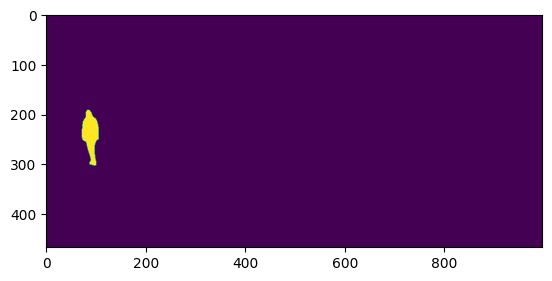

Moore Boundary Tracing
(467, 997)


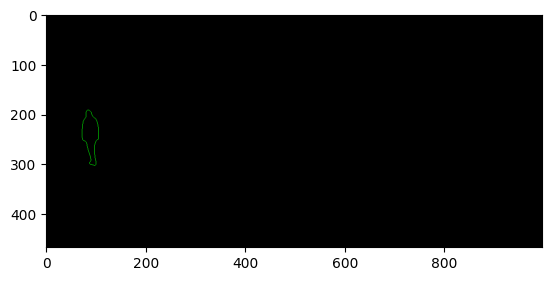

contour :  1
mask


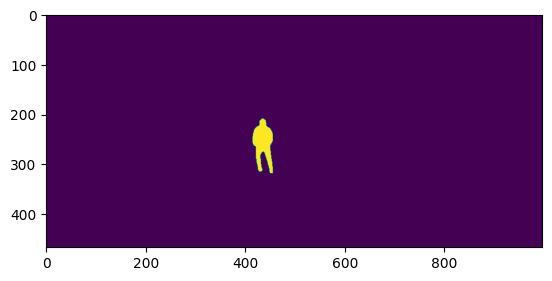

Moore Boundary Tracing
(467, 997)


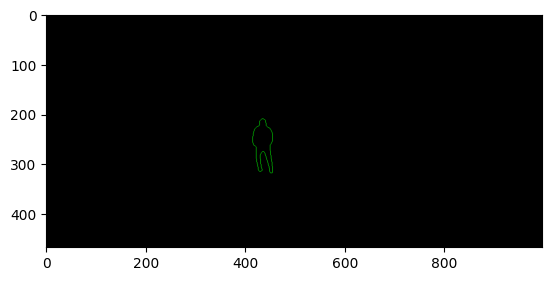

contour :  2
mask


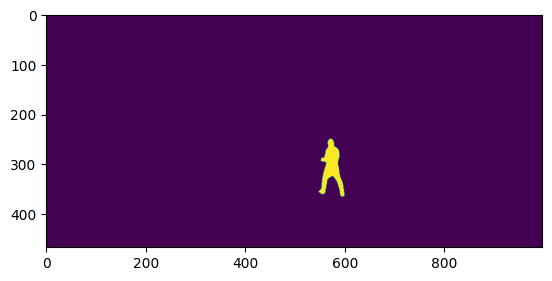

Moore Boundary Tracing
(467, 997)


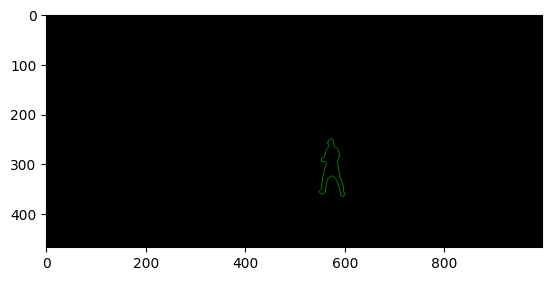

contour :  3
mask


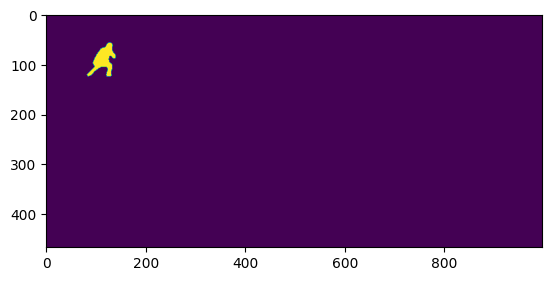

Moore Boundary Tracing
(467, 997)


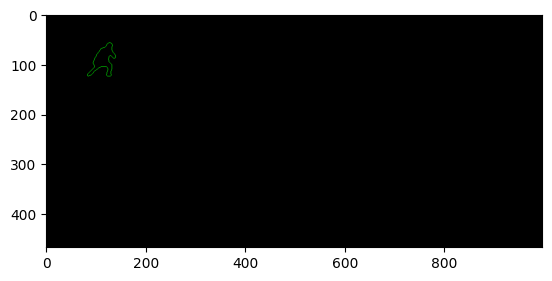

contour :  4
mask


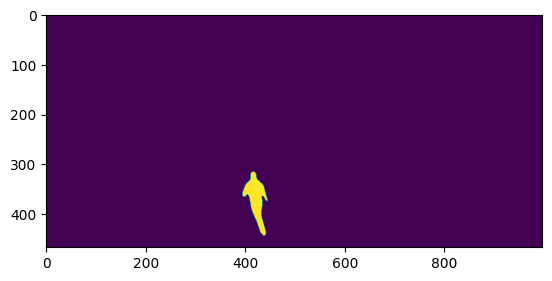

Moore Boundary Tracing
(467, 997)


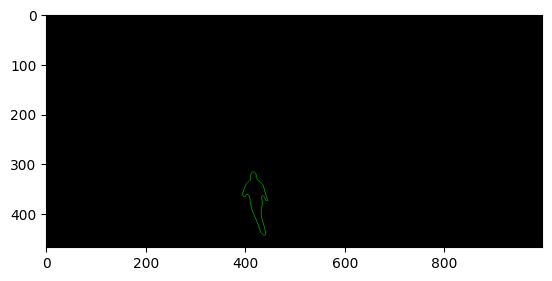

contour :  5
mask


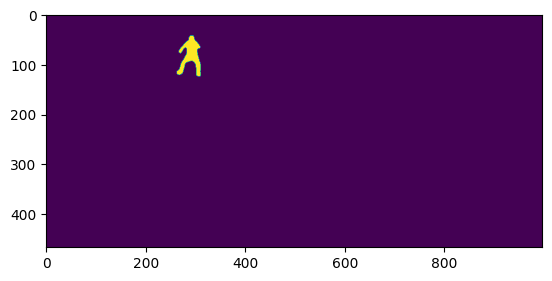

Moore Boundary Tracing
(467, 997)


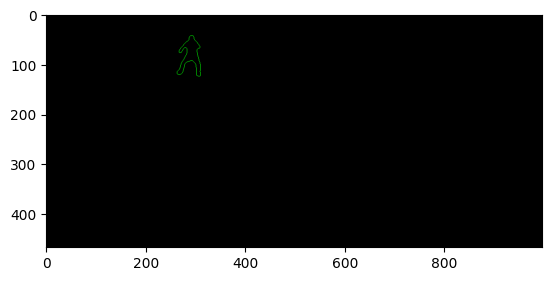

contour :  6
mask


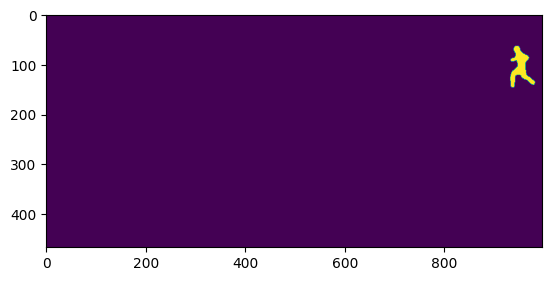

Moore Boundary Tracing
(467, 997)


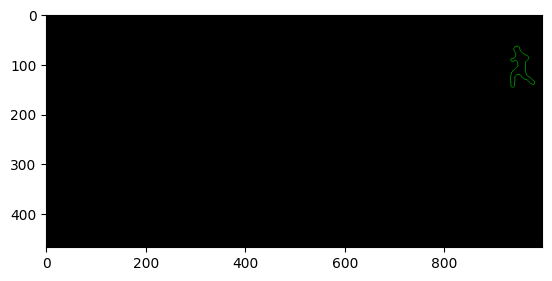

contour :  7
mask


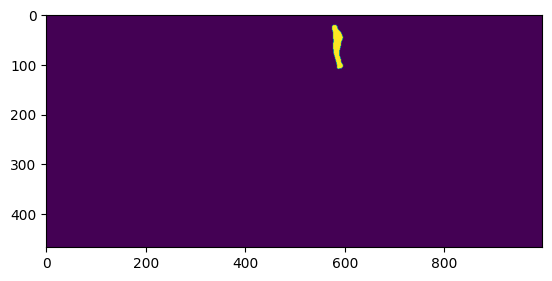

Moore Boundary Tracing
(467, 997)


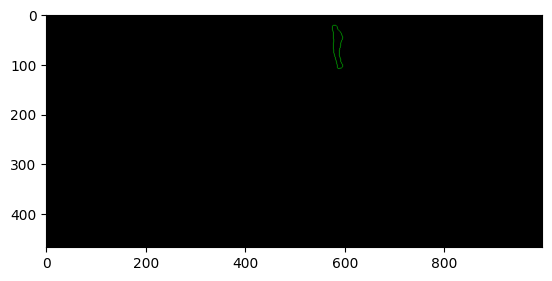

contour :  8
mask


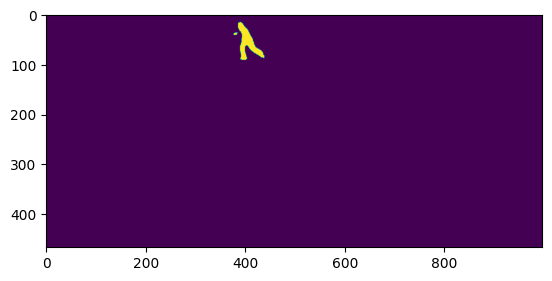

Moore Boundary Tracing
(467, 997)


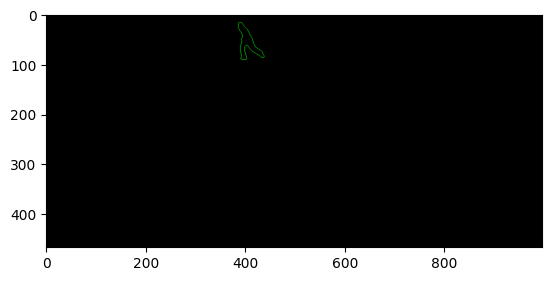

contour :  9
mask


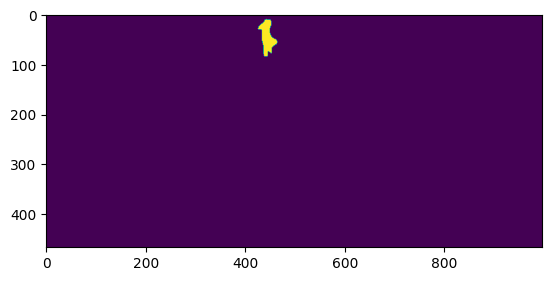

Moore Boundary Tracing
(467, 997)


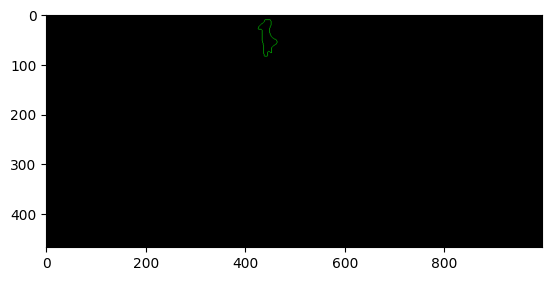

contour :  10
mask


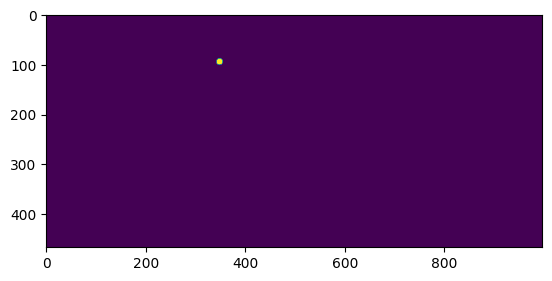

Moore Boundary Tracing
(467, 997)


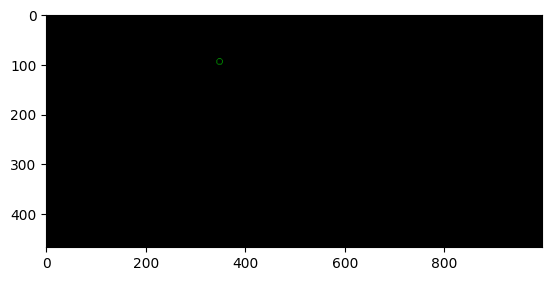

contour :  11
mask


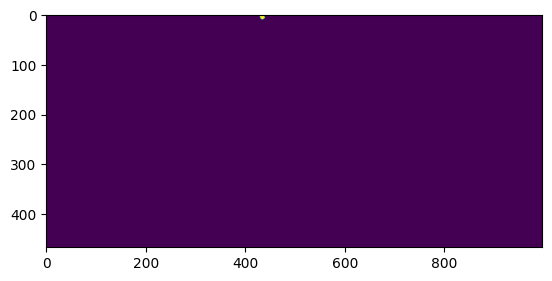

Moore Boundary Tracing
(467, 997)


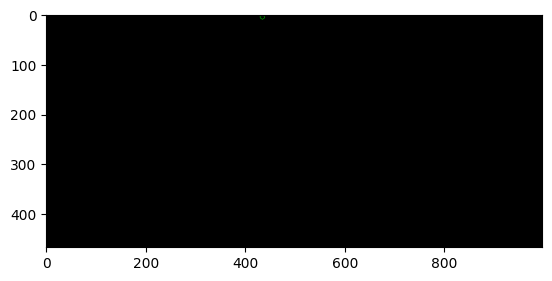

contour :  12
mask


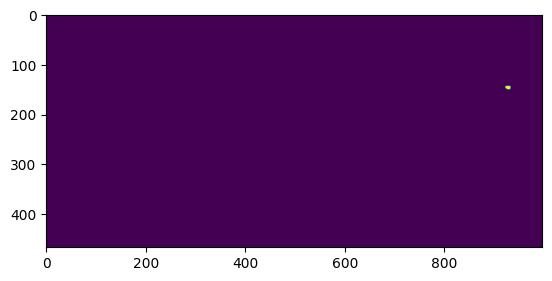

Moore Boundary Tracing
(467, 997)


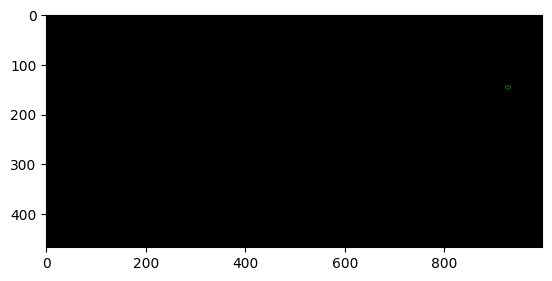

contour :  13
mask


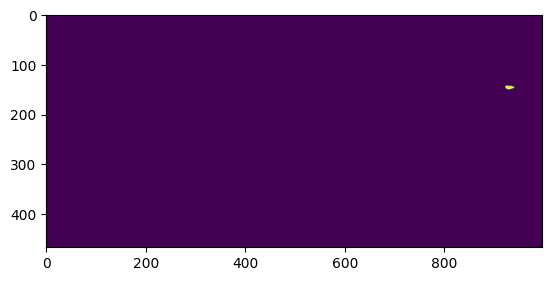

Moore Boundary Tracing
(467, 997)


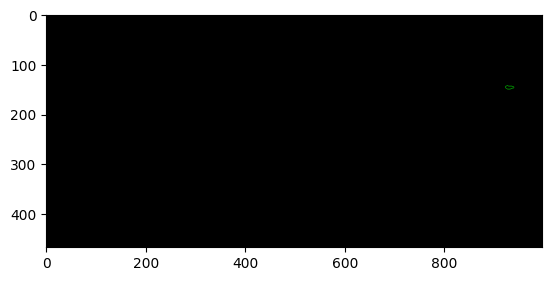

contour :  14
mask


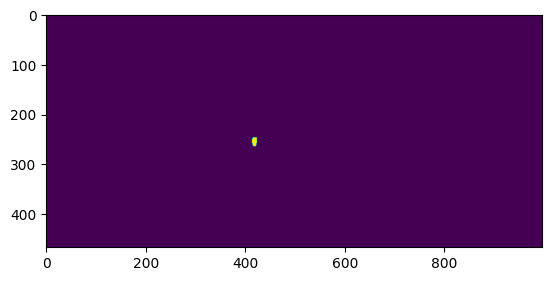

Moore Boundary Tracing
(467, 997)


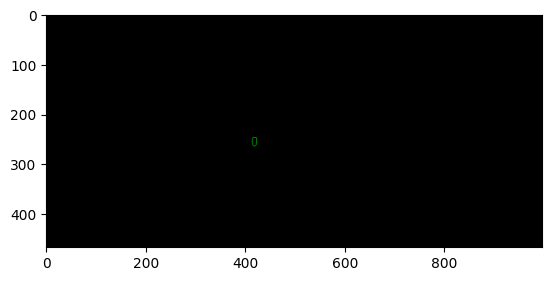

contour :  15
mask


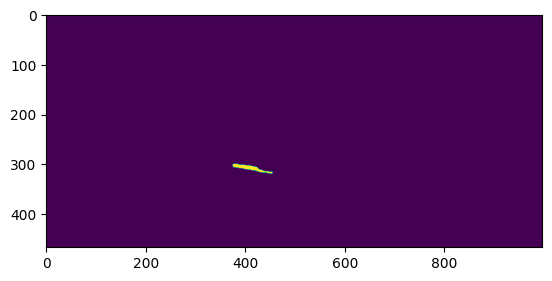

Moore Boundary Tracing
(467, 997)


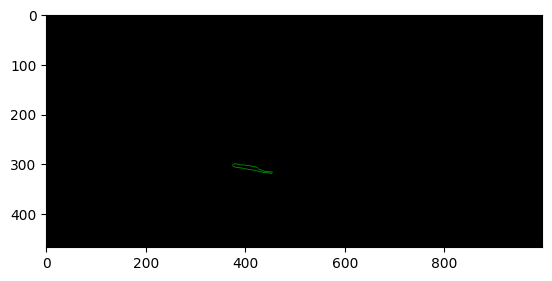

contour :  16
mask


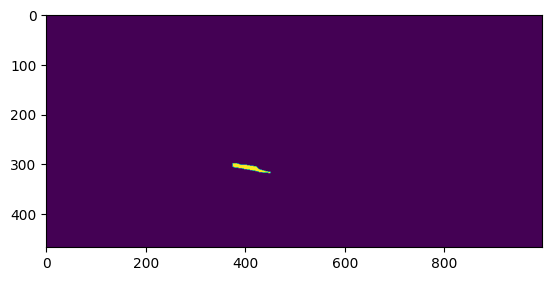

Moore Boundary Tracing
(467, 997)


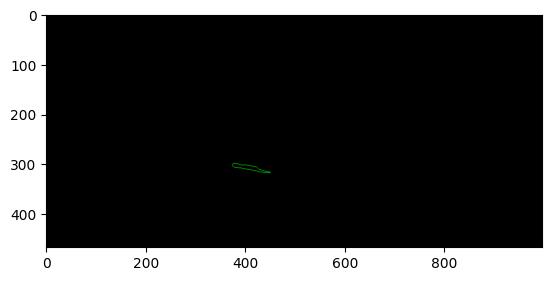

contour :  17
mask


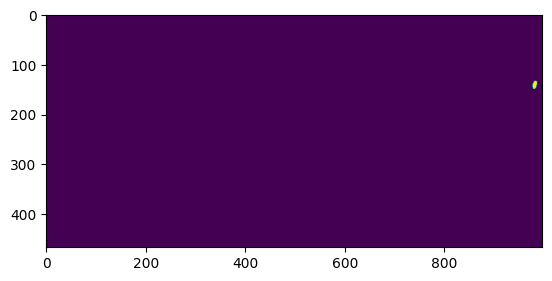

Moore Boundary Tracing
(467, 997)


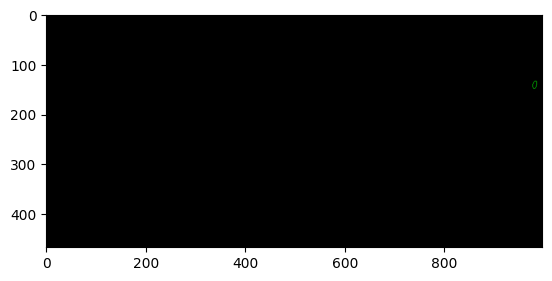

contour :  18
mask


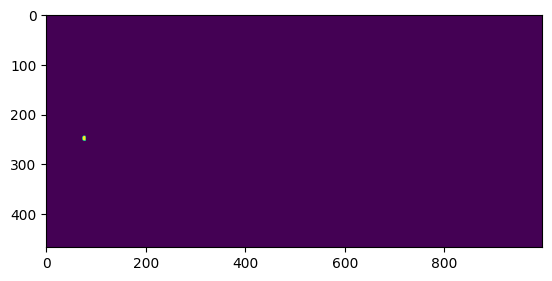

Moore Boundary Tracing
(467, 997)


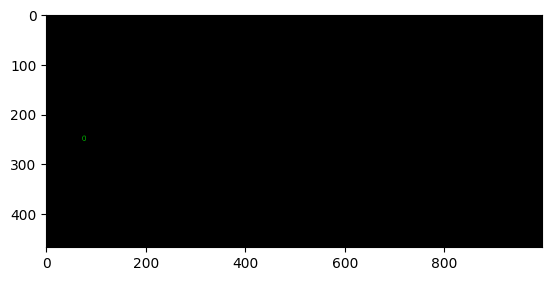

contour :  19
mask


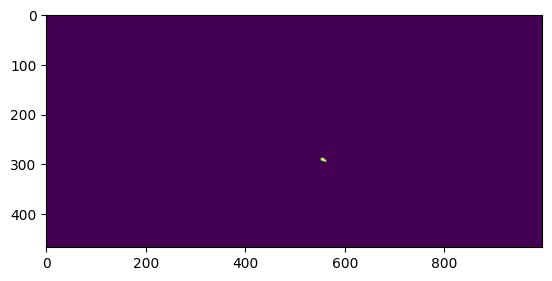

Moore Boundary Tracing
(467, 997)


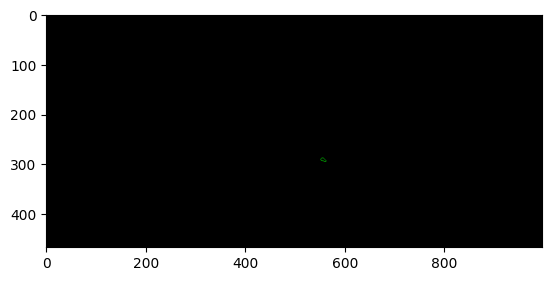

contour :  20
mask


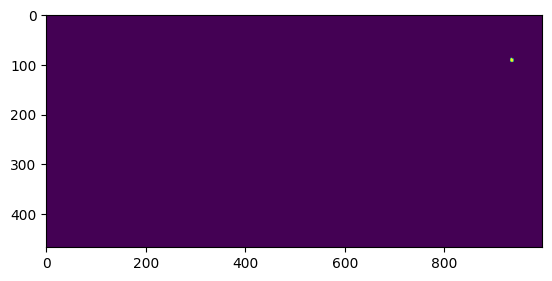

Moore Boundary Tracing
(467, 997)


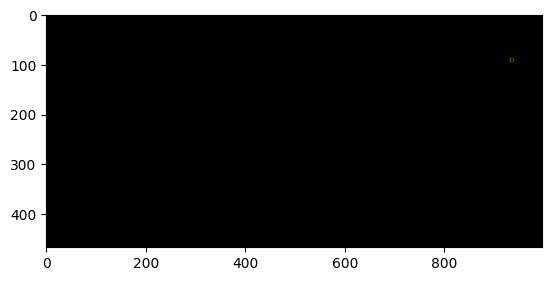

contour :  21
mask


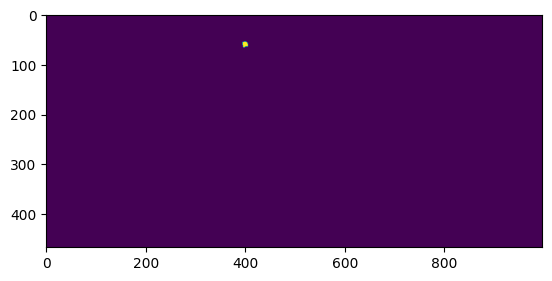

Moore Boundary Tracing
(467, 997)


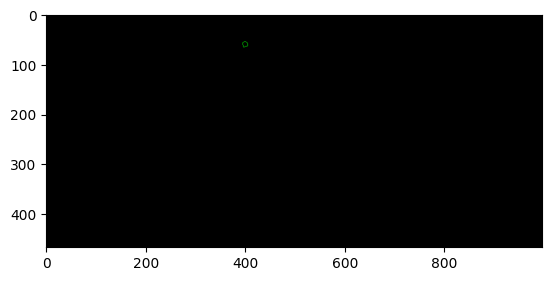

contour :  22
mask


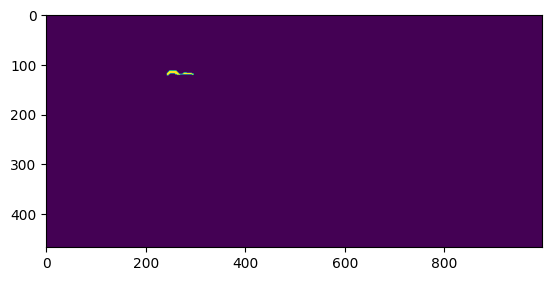

Moore Boundary Tracing
(467, 997)


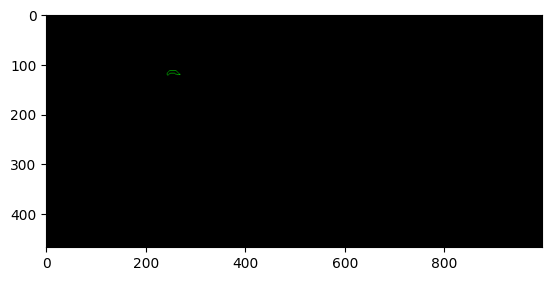

contour :  23
mask


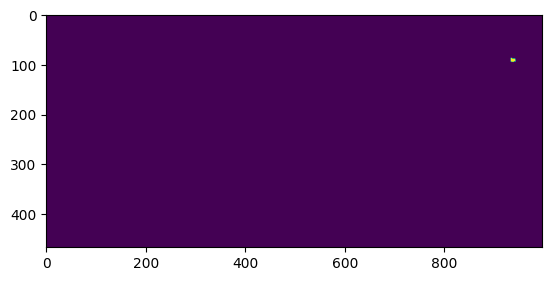

Moore Boundary Tracing
(467, 997)


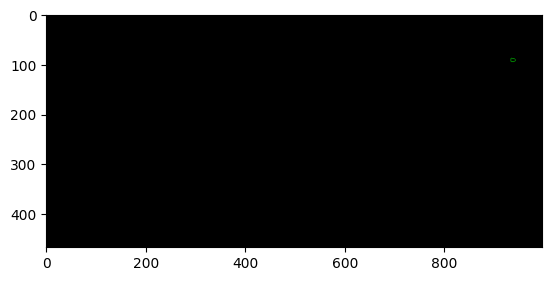

[array([[[ 83, 192]],
 
        [[ 82, 193]],
 
        [[ 81, 194]],
 
        [[ 81, 195]],
 
        [[ 80, 196]],
 
        [[ 80, 197]],
 
        [[ 80, 198]],
 
        [[ 80, 199]],
 
        [[ 80, 200]],
 
        [[ 80, 201]],
 
        [[ 80, 202]],
 
        [[ 80, 203]],
 
        [[ 80, 204]],
 
        [[ 80, 205]],
 
        [[ 80, 206]],
 
        [[ 79, 207]],
 
        [[ 78, 208]],
 
        [[ 78, 209]],
 
        [[ 77, 210]],
 
        [[ 76, 211]],
 
        [[ 76, 212]],
 
        [[ 75, 213]],
 
        [[ 75, 214]],
 
        [[ 74, 215]],
 
        [[ 74, 216]],
 
        [[ 74, 217]],
 
        [[ 74, 218]],
 
        [[ 74, 219]],
 
        [[ 73, 220]],
 
        [[ 73, 221]],
 
        [[ 73, 222]],
 
        [[ 73, 223]],
 
        [[ 73, 224]],
 
        [[ 73, 225]],
 
        [[ 73, 226]],
 
        [[ 73, 227]],
 
        [[ 73, 228]],
 
        [[ 73, 229]],
 
        [[ 72, 230]],
 
        [[ 72, 231]],
 
        [[ 72, 232]],
 
        [[ 72, 2

In [ ]:
def get_countours(image, show_mask):
  i = 0
  contours = []
  for pred_mask in predictor(image)['instances'].pred_masks:
      print('contour : ', i)
      mask = pred_mask.to("cpu").numpy().astype('uint8')
      if show_mask:
        print('mask')
        plt.imshow(mask)
        plt.show()
        print("Moore Boundary Tracing")
        #msk= cv2.merge([mask,mask,mask])
        print(mask.shape)
        #cv2_imshow(msk)


        msk= cv2.cvtColor(mask,cv2.COLOR_GRAY2BGR)*255
        # cv2_imshow(msk)
        boundary=moore(msk)
        boundaries.append(boundary)
        plt.imshow(boundary)
        plt.show()
      contour, _ = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
      i += 1
      contours.append(contour[0])
  return contours
get_countours(image, True)

In [ ]:
lengths_of_objs=[]
def length(boundaries):
  for bnd_img in boundaries:
    bound_image=cv2.cvtColor(bnd_img.astype(numpy.uint8), cv2.COLOR_BGR2GRAY)
    cv2_imshow(bound_image)
    _,boundary_img = cv2.threshold(bound_image, 50,255, cv2.THRESH_BINARY)
    #cv2_imshow(boundary_img)
    # print(numpy.unique(bnd_image))
    n_white_pix = numpy.sum(boundary_img)
    lengths_of_objs.append(n_white_pix)
    print('Number of white pixels in image:', n_white_pix)

In [ ]:
length(boundaries)

In [ ]:
length_threshold=30000
for i in lengths_of_objs:
  if i>30000:
    ind=lengths_of_objs.index(i)
    print("HUMAN CONTOUR SEPERATED USING LENGTH OF BOUNDARIES")
    cv2_imshow(boundaries[ind])
    print("----------------------------------------------------------------")

##GLCM

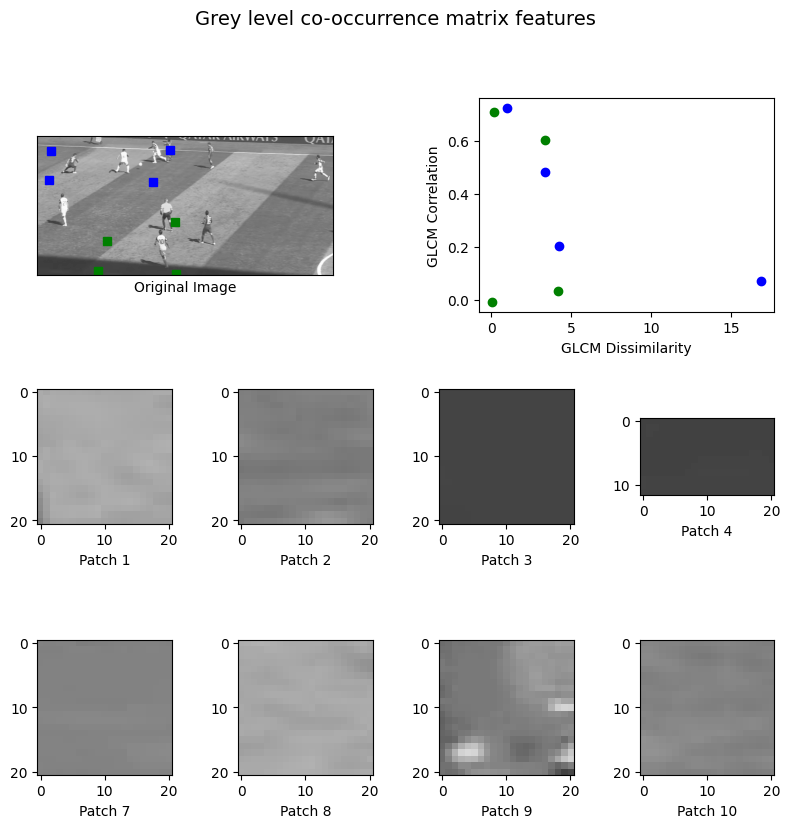

In [ ]:
import matplotlib.pyplot as plt

from skimage.feature import graycomatrix, graycoprops
from skimage import data


PATCH_SIZE = 21

# open the camera image
image = cv2.imread('/content/drive/MyDrive/Football_Data/001.jpeg')
image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)

# select some patches from grassy areas of the image
grass_locations = [(280, 454), (342, 223), (444, 192), (455, 455)]
grass_patches = []
for loc in grass_locations:
    grass_patches.append(image[loc[0]:loc[0] + PATCH_SIZE,
                               loc[1]:loc[1] + PATCH_SIZE])

# select some patches from sky areas of the image
sky_locations = [(38, 34), (139, 28), (37, 437), (145, 379)]
sky_patches = []
for loc in sky_locations:
    sky_patches.append(image[loc[0]:loc[0] + PATCH_SIZE,
                             loc[1]:loc[1] + PATCH_SIZE])

# compute some GLCM properties each patch
xs = []
ys = []
for patch in (grass_patches + sky_patches):
    glcm = graycomatrix(patch, distances=[5], angles=[0], levels=256,
                        symmetric=True, normed=True)
    xs.append(graycoprops(glcm, 'dissimilarity')[0, 0])
    ys.append(graycoprops(glcm, 'correlation')[0, 0])

# create the figure
fig = plt.figure(figsize=(8, 8))

# display original image with locations of patches
ax = fig.add_subplot(3, 2, 1)
ax.imshow(image, cmap=plt.cm.gray,
          vmin=0, vmax=255)
for (y, x) in grass_locations:
    ax.plot(x + PATCH_SIZE / 2, y + PATCH_SIZE / 2, 'gs')
for (y, x) in sky_locations:
    ax.plot(x + PATCH_SIZE / 2, y + PATCH_SIZE / 2, 'bs')
ax.set_xlabel('Original Image')
ax.set_xticks([])
ax.set_yticks([])
ax.axis('image')

# for each patch, plot (dissimilarity, correlation)
ax = fig.add_subplot(3, 2, 2)
ax.plot(xs[:len(grass_patches)], ys[:len(grass_patches)], 'go',
        label='Grass')
ax.plot(xs[len(grass_patches):], ys[len(grass_patches):], 'bo',
        label='Sky')
ax.set_xlabel('GLCM Dissimilarity')
ax.set_ylabel('GLCM Correlation')
#ax.legend()
num=1
# display the image patches
for i, patch in enumerate(grass_patches):
    ax = fig.add_subplot(3, len(grass_patches), len(grass_patches)*1 + i + 1)
    ax.imshow(patch, cmap=plt.cm.gray,
              vmin=0, vmax=255)
    num=num+1
    ax.set_xlabel(f"Patch {i + 1}")

for i, patch in enumerate(sky_patches):
    ax = fig.add_subplot(3, len(sky_patches), len(sky_patches)*2 + i + 1)
    ax.imshow(patch, cmap=plt.cm.gray,
              vmin=0, vmax=255)
    num=num+1
    ax.set_xlabel(f"Patch {num + 1}")


# display the patches and plot
fig.suptitle('Grey level co-occurrence matrix features', fontsize=14, y=1.05)
plt.tight_layout()
plt.show()

Actual GLCM Matrix

In [ ]:
def vectorized_glcm(image, distance, direction):

    img = numpy.array(image)

    glcm = numpy.zeros((256, 256), dtype=int)

    if direction == 1:
        first = img[distance:, :]
        second = img[:-distance, :]
    elif direction == 2:
        first = img[distance:, :-distance]
        second = img[:-distance, distance:]
    elif direction == 3:
        first = img[:, :-distance]
        second = img[:, distance:]
    elif direction == 4:
        first = img[:-distance, :-distance]
        second = img[distance:, distance:]

    for i, j in zip(first.ravel(), second.ravel()):
        glcm[i, j] += 1

    return glcm

In [ ]:
image = cv2.imread('/content/drive/MyDrive/Football_Data/001.jpeg')
image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
glcm=vectorized_glcm(image,1,1)
print(glcm)

[[ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]
 ...
 [ 0  0  0 ... 72 33 10]
 [ 0  0  0 ... 42 70 16]
 [ 0  0  0 ... 14 26 33]]


##Histogram for Texture Analysis

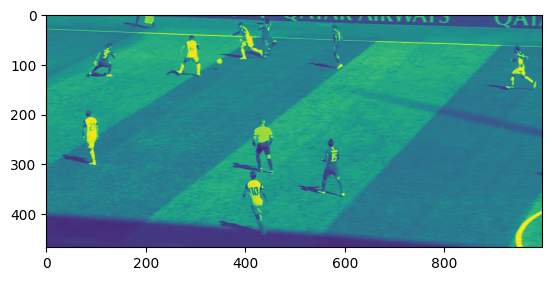

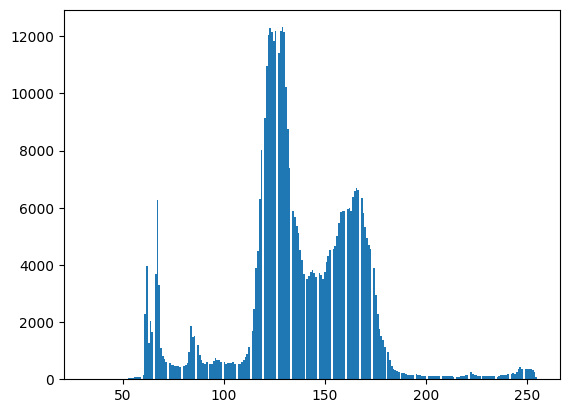

In [ ]:
from skimage import io
import matplotlib.pyplot as plt
image = cv2.imread('/content/drive/MyDrive/Football_Data/001.jpeg')
gray_image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
plt.imshow(gray_image)
plt.show()
ax = plt.hist(gray_image.ravel(), bins = 256)
plt.show()

Histogram for an RGB image

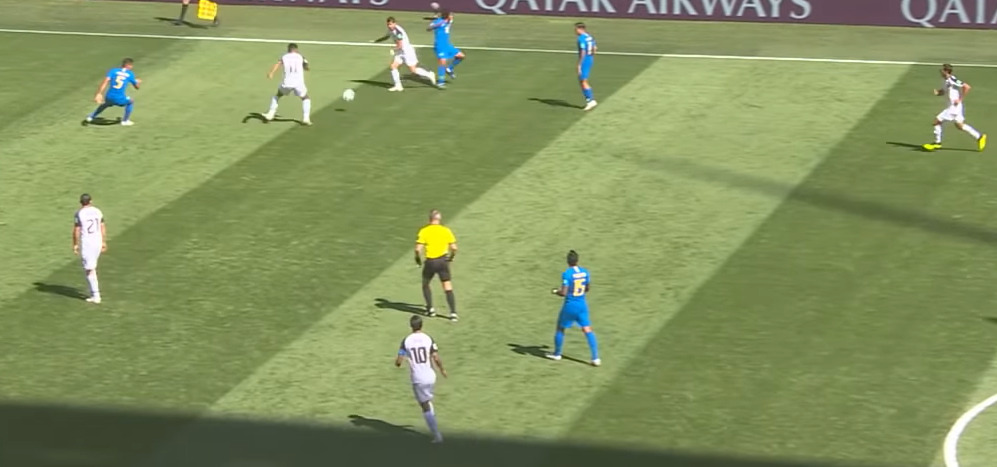

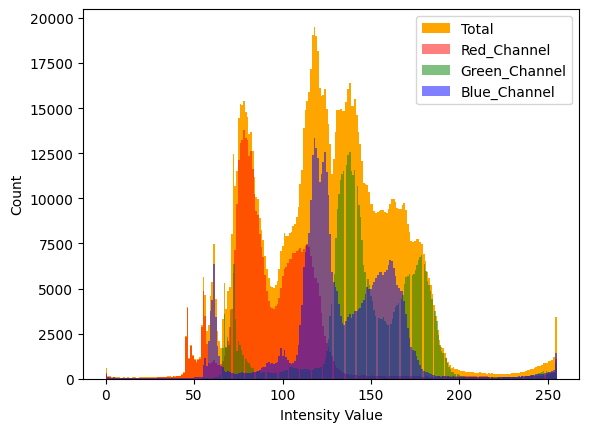

In [ ]:
from skimage import io
import matplotlib.pyplot as plt
image = cv2.imread('/content/drive/MyDrive/Football_Data/001.jpeg')
cv2_imshow(image)
_ = plt.hist(image.ravel(), bins = 256, color = 'orange', )
_ = plt.hist(image[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
_ = plt.hist(image[:, :, 1].ravel(), bins = 256, color = 'Green', alpha = 0.5)
_ = plt.hist(image[:, :, 2].ravel(), bins = 256, color = 'Blue', alpha = 0.5)
_ = plt.xlabel('Intensity Value')
_ = plt.ylabel('Count')
_ = plt.legend(['Total', 'Red_Channel', 'Green_Channel', 'Blue_Channel'])
plt.show()

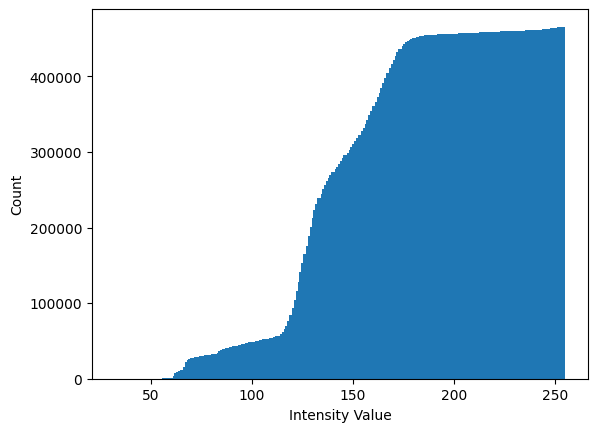

In [ ]:
from skimage import io
import matplotlib.pyplot as plt
image = cv2.imread('/content/drive/MyDrive/Football_Data/001.jpeg')
gray_image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
_ = plt.hist(gray_image.ravel(), bins = 256, cumulative = True)
_ = plt.xlabel('Intensity Value')
_ = plt.ylabel('Count')
plt.show()

###Histogram Analysis on GLCM Features

In [ ]:
from PIL import Image
image_directory = '/content/drive/MyDrive/Football_Data'
image_dataset = []
images = os.listdir(image_directory)
for i, image_name in enumerate(images):    #Remember enumerate method adds a counter and returns the enumerate object
    if (image_name.split('.')[1] == 'jpeg'):
        #print(image_directory+image_name)
        image = cv2.imread(image_directory+"/"+image_name)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (1280, 720))
        image = Image.fromarray(image)
        image_dataset.append(np.array(image))
image_dataset = np.array(image_dataset)
image_dataset.shape

(7, 720, 1280, 3)

In [ ]:
image = cv2.imread('/content/drive/MyDrive/Football_Data/001.jpeg')
image_gray=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
g = greycomatrix(image_gray, [1, 2], [0, np.pi/2], levels=256,normed=True, symmetric=True)
contrast = greycoprops(g, 'contrast')
contrast

/usr/local/lib/python3.9/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.9/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')


array([[ 29.90968585,  80.29308526],
       [ 96.46453466, 206.28880836]])

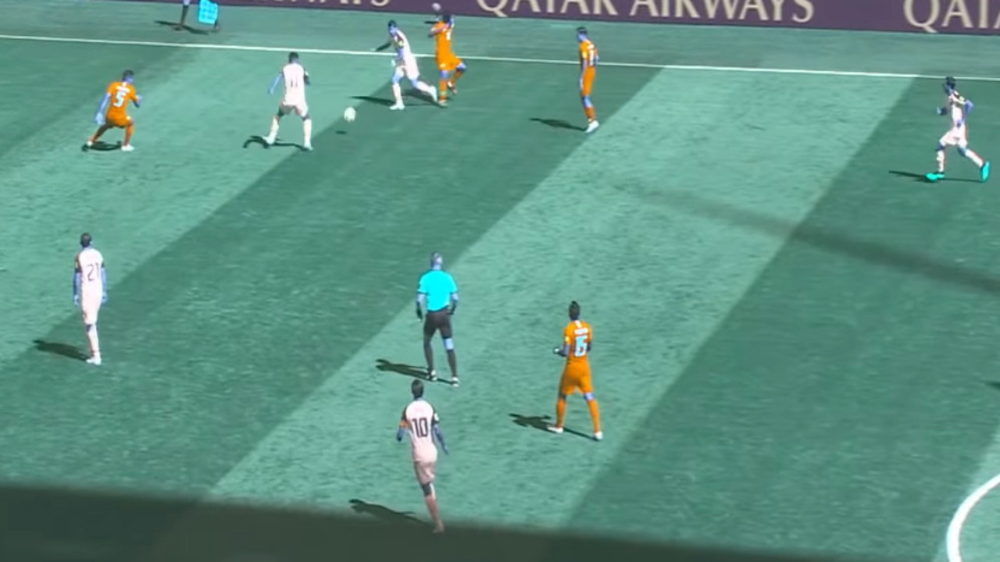

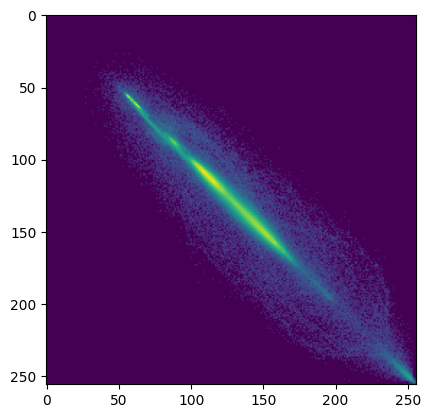

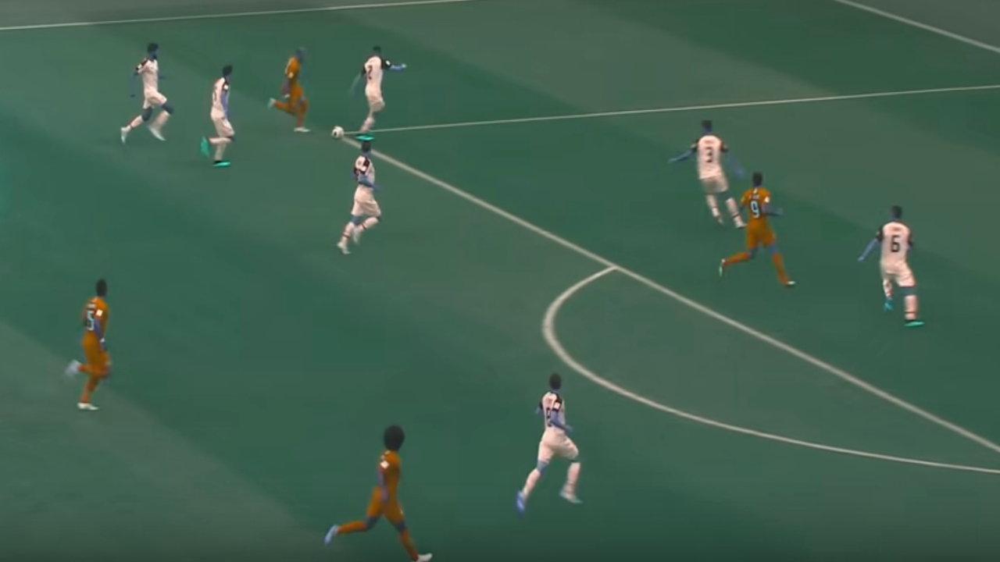

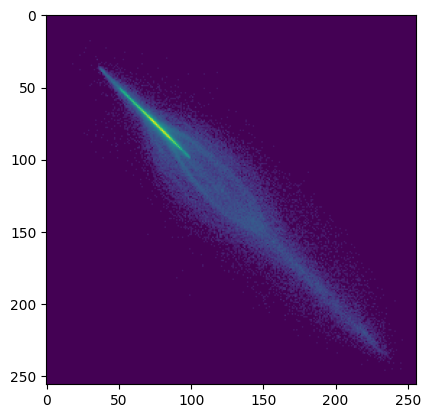

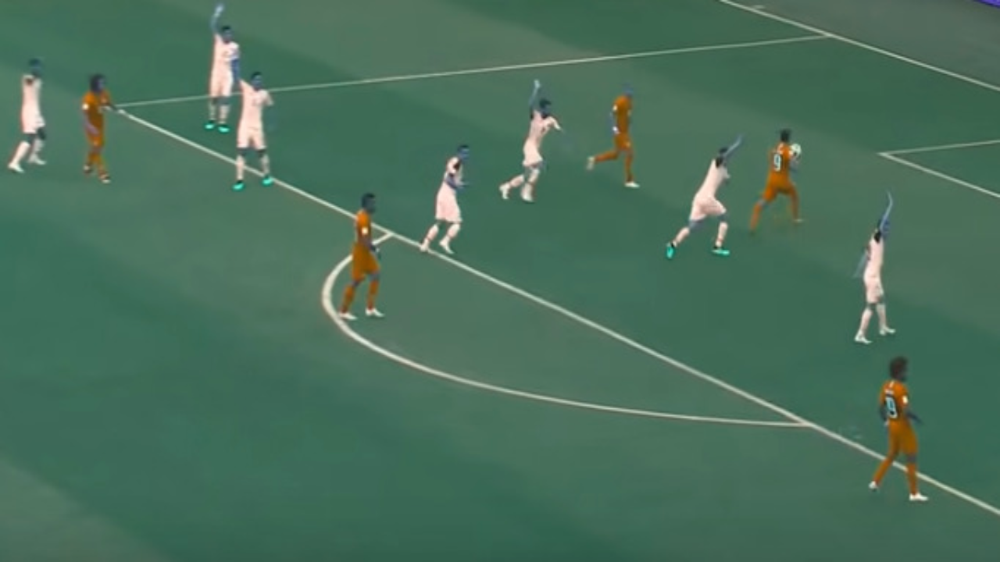

...

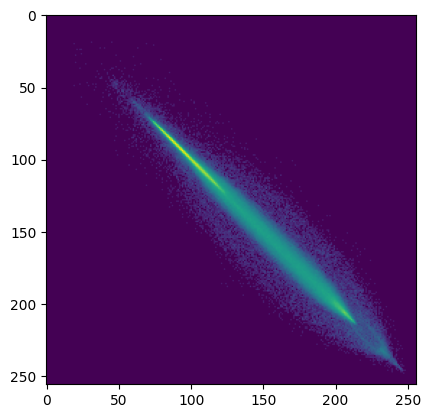

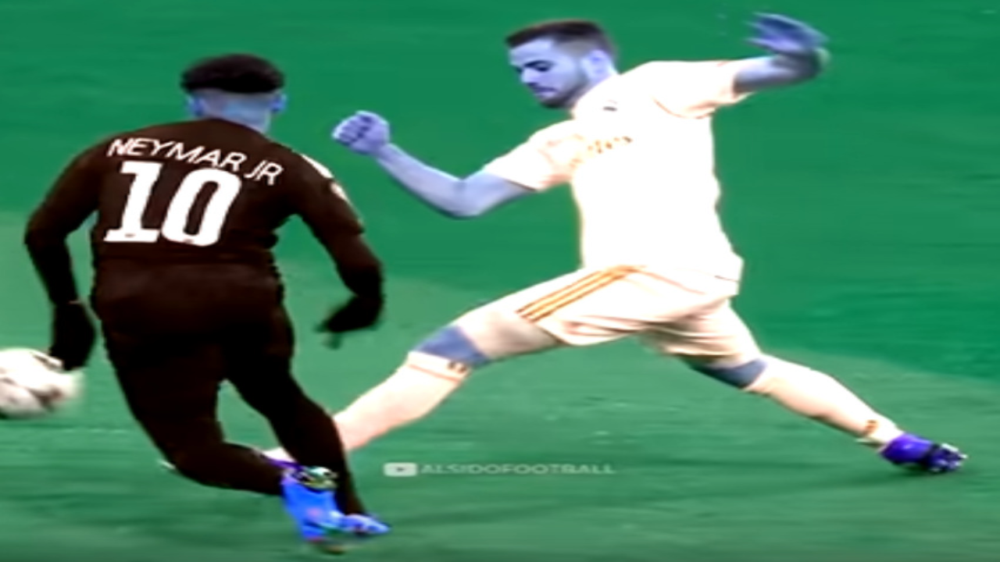

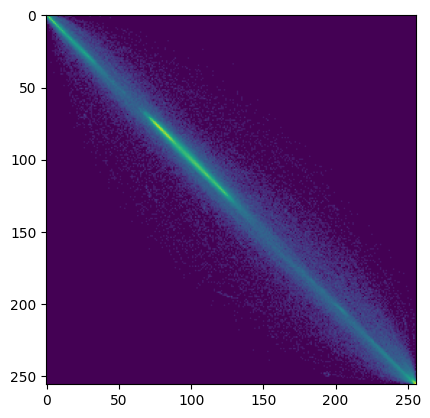

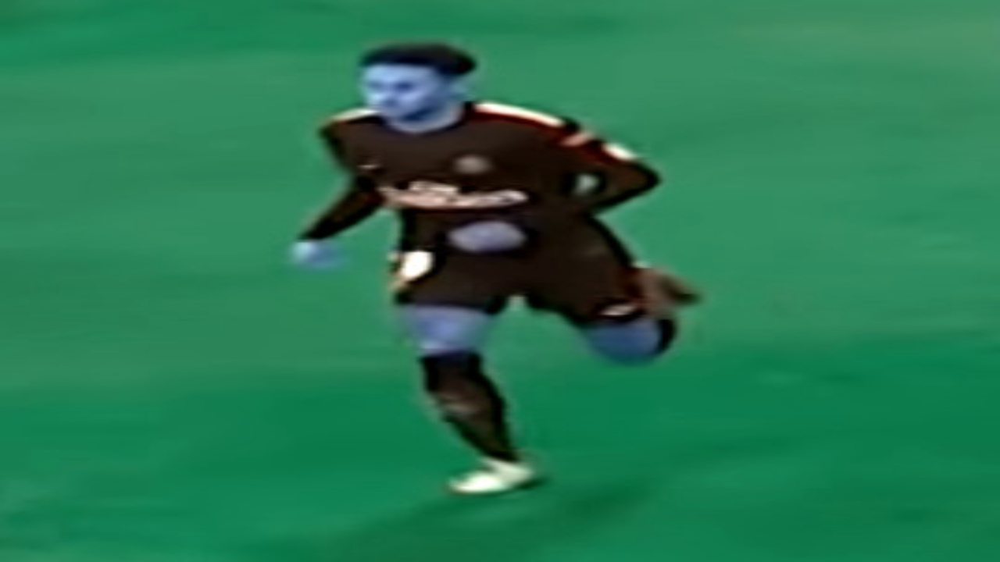

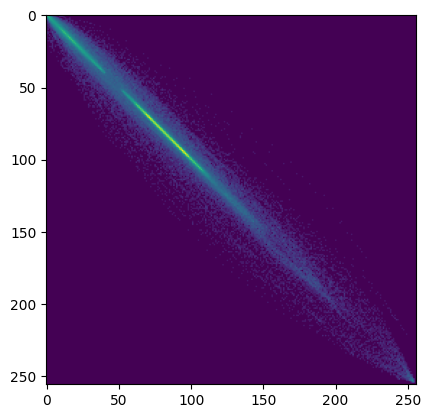

In [ ]:
from matplotlib import pyplot as plt
import numpy as np

# load an image
for img_rgb in image_dataset:
  cv2_imshow(img_rgb)

  # get img greyscale
  finl_img = np.average(img_rgb,axis=2).astype(np.uint8)

  # choose a positional operator
  pos_op = [1,0]

  # init glcm array
  glcm = np.zeros([256,256])

  # iterate over image and complete glcm
  for i in range(finl_img.shape[0]): # row
      for j in range(finl_img.shape[1]): # col
          init_val = finl_img[i,j]
          try:
              target = finl_img[i+pos_op[0],j+pos_op[1]]
          except IndexError:
            continue # out of img bounds
          glcm[init_val,target]+=1

  glcm = glcm/np.sum(glcm)

  plt.imshow(np.log(glcm+1e-6))
  plt.show()

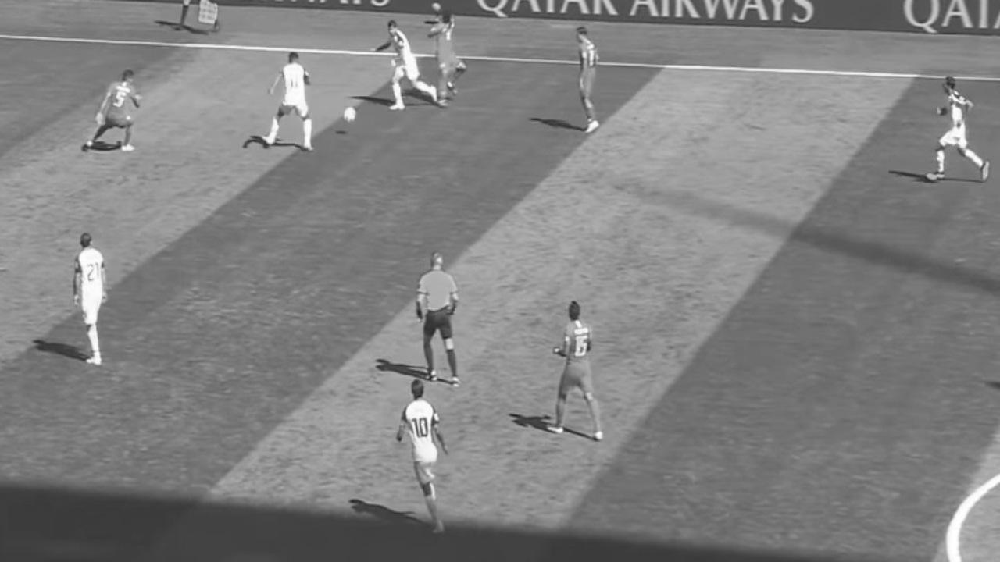

/usr/local/lib/python3.9/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')


[[15.45764812 27.85300439]
 [54.43006325 90.61708522]]


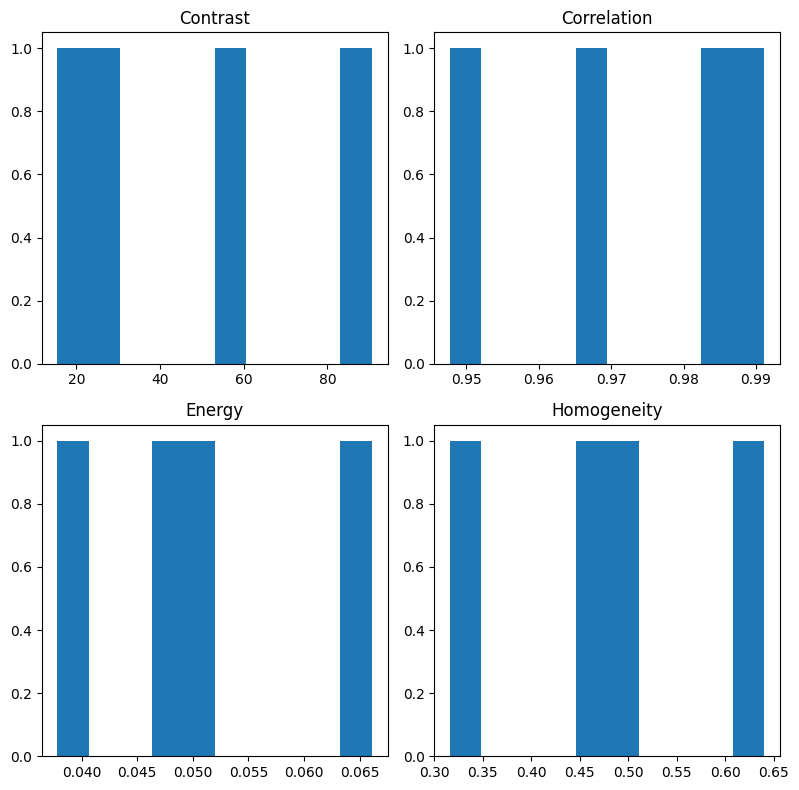

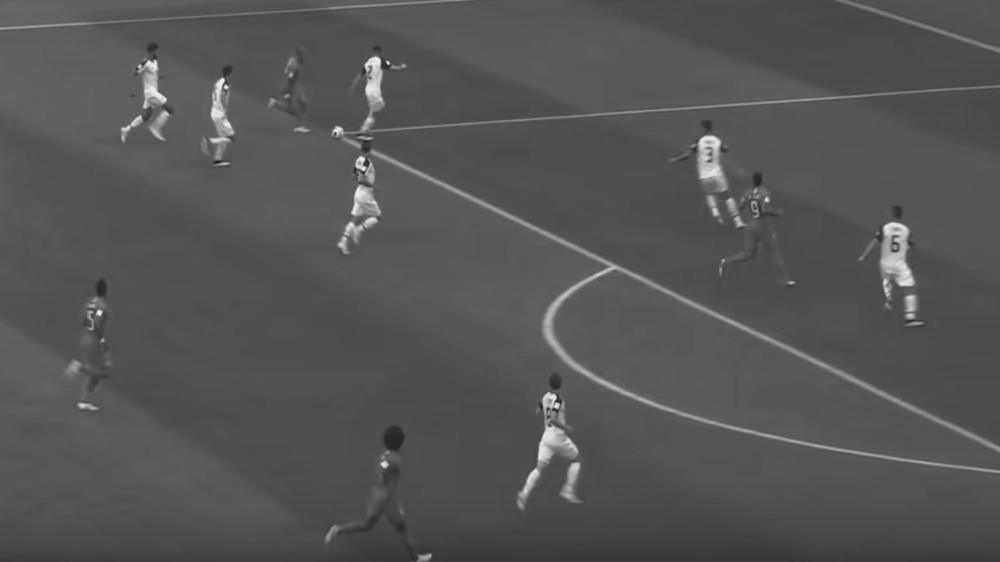

/usr/local/lib/python3.9/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')


[[ 8.16558618 14.06876739]
 [28.95551535 46.52013732]]


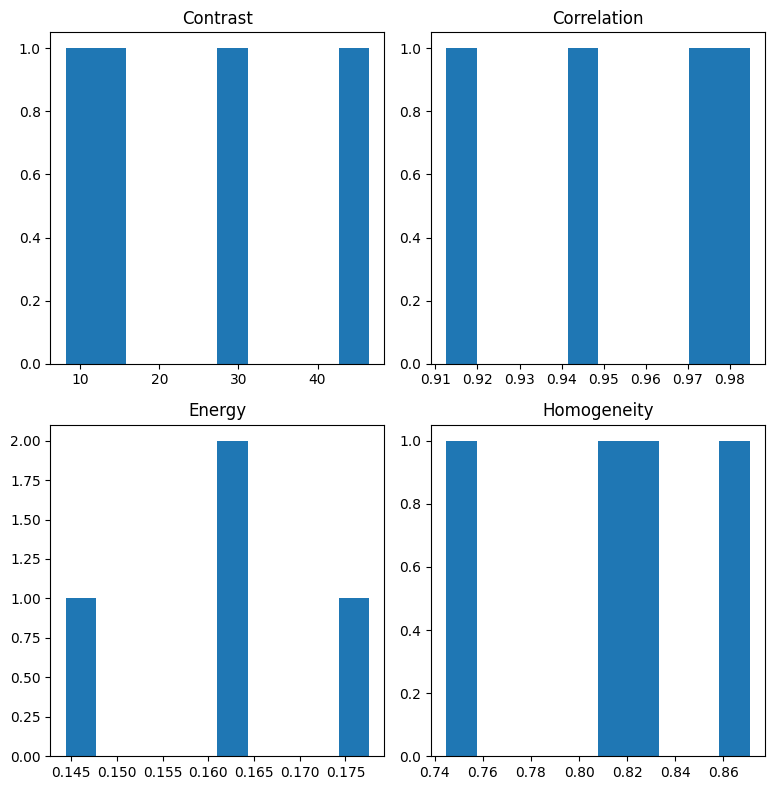

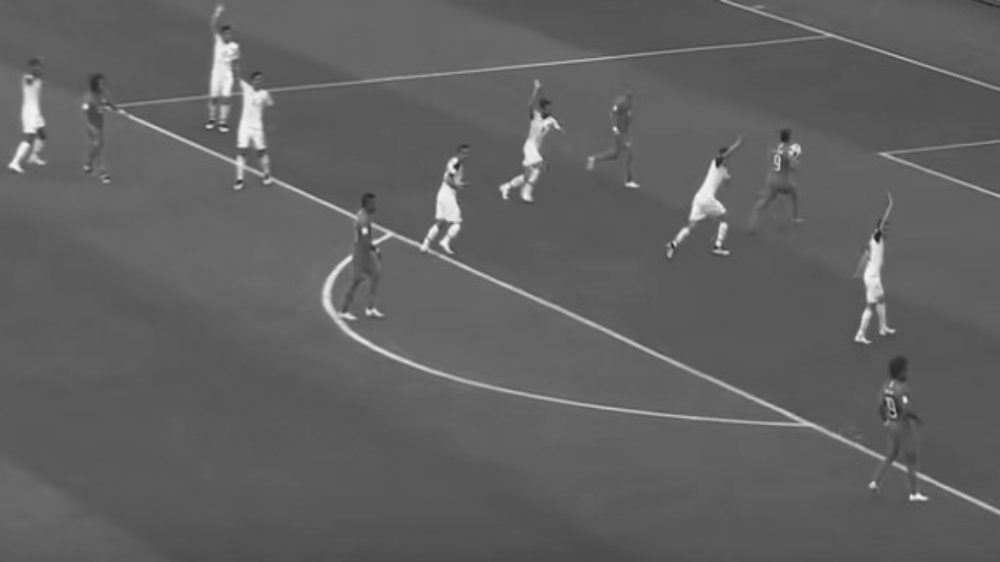

/usr/local/lib/python3.9/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')


[[ 8.77847711 16.68380237]
 [32.36048839 57.02012644]]


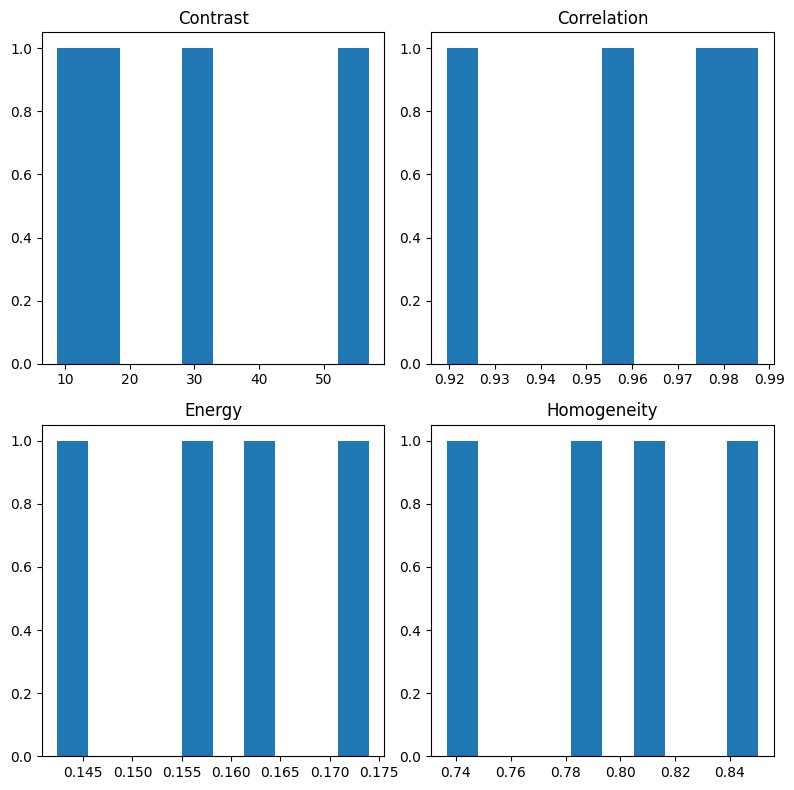

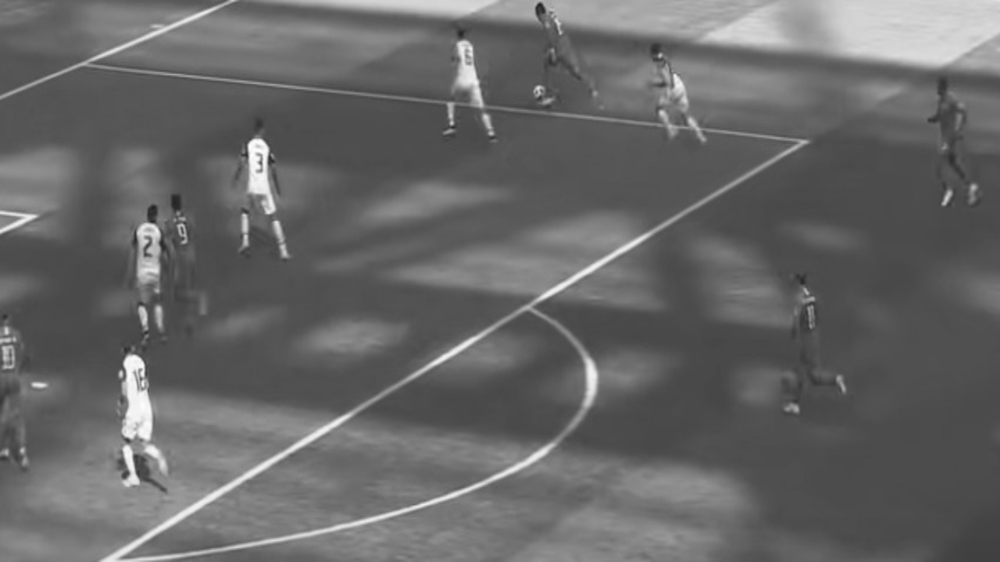

/usr/local/lib/python3.9/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')


[[ 9.5778071  15.19687174]
 [34.6912776  54.01281337]]


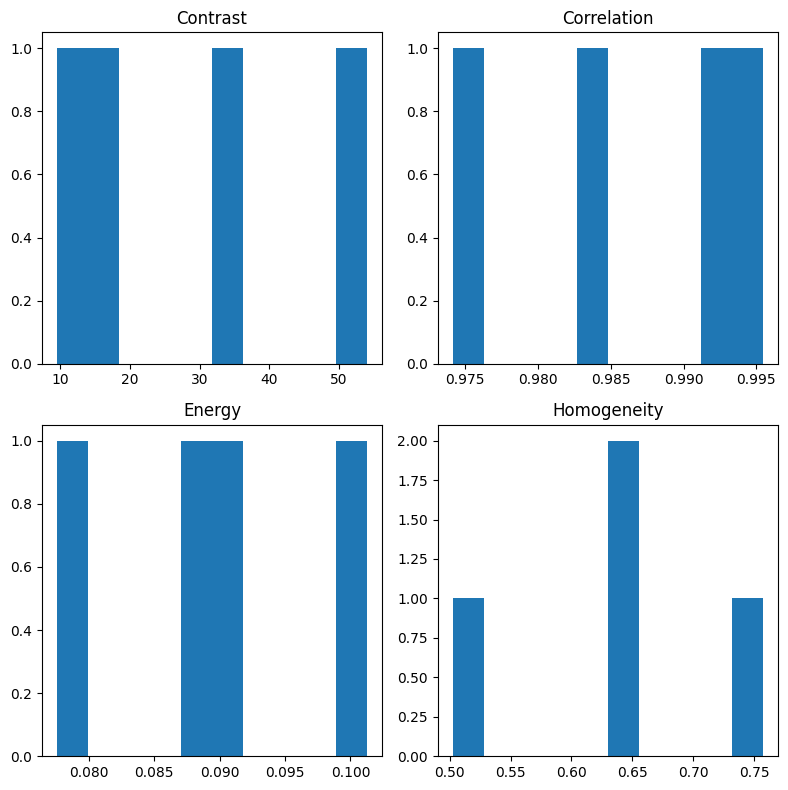

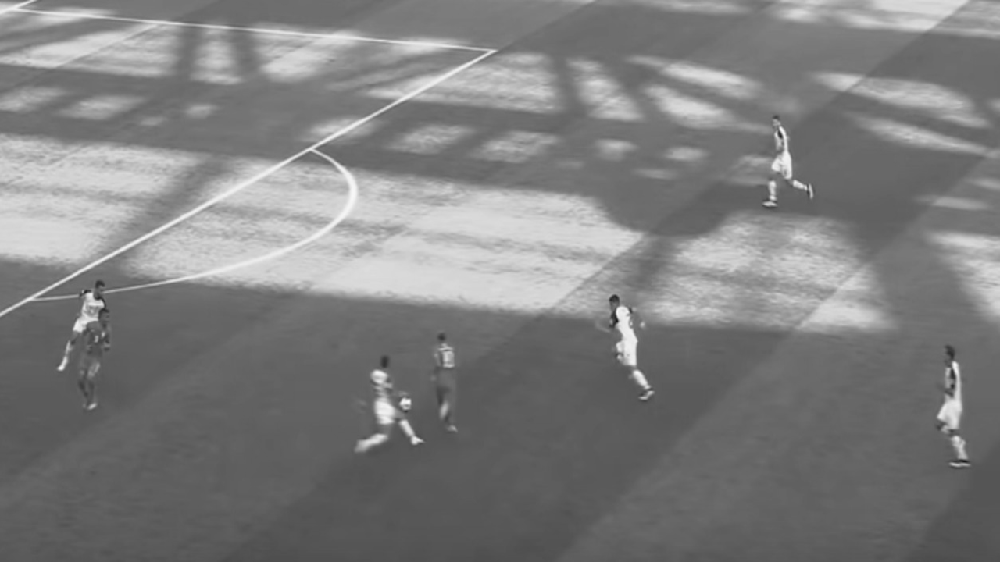

/usr/local/lib/python3.9/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')


[[ 6.27946421 15.49294919]
 [22.69152539 54.20329692]]


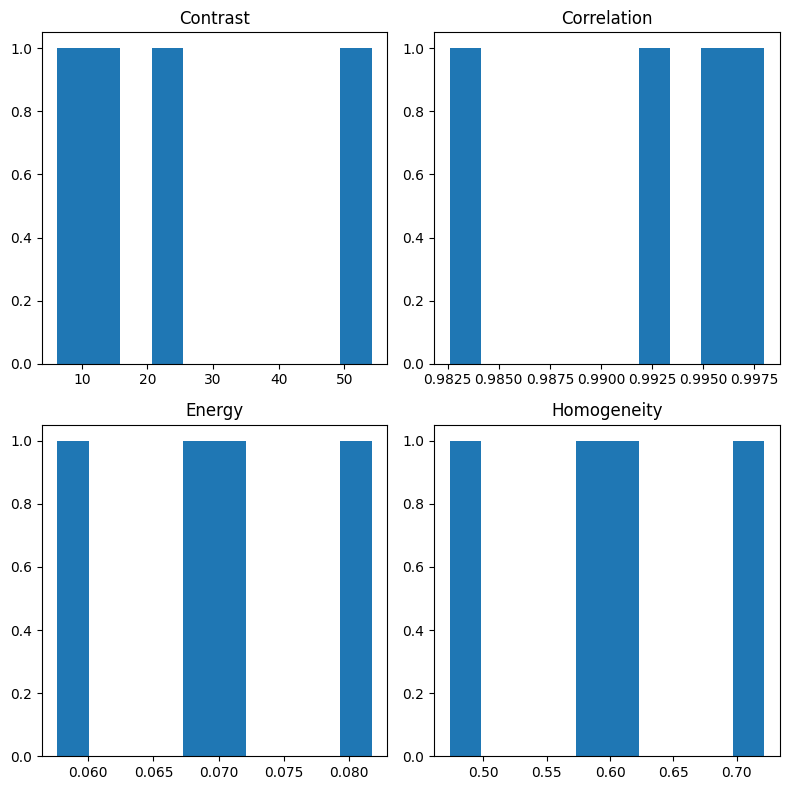

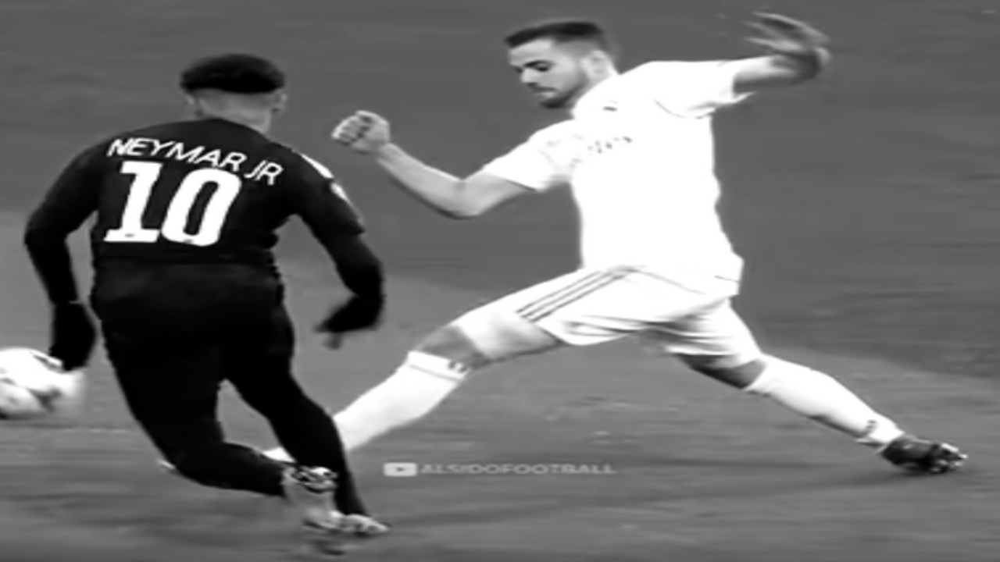

/usr/local/lib/python3.9/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')


[[ 15.99323908  28.54080429]
 [ 60.42714963 104.82637426]]


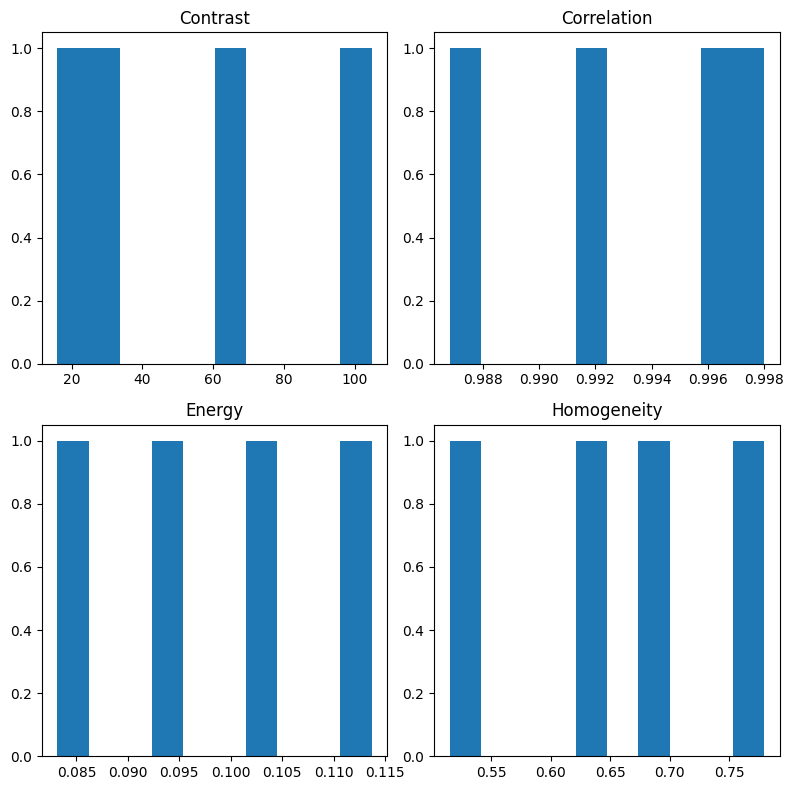

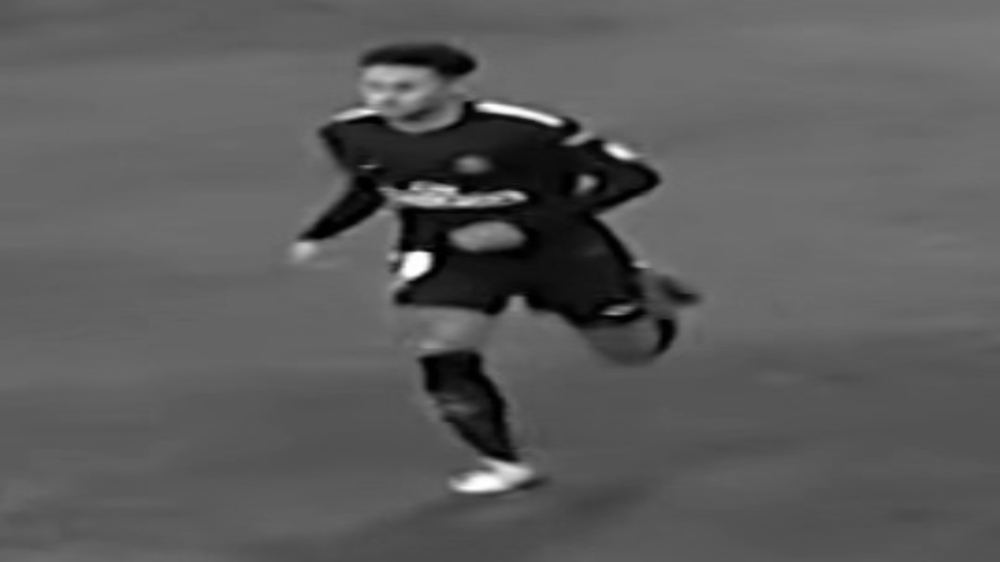

/usr/local/lib/python3.9/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')


[[ 1.67923074  6.55597292]
 [ 6.37408929 24.68531294]]


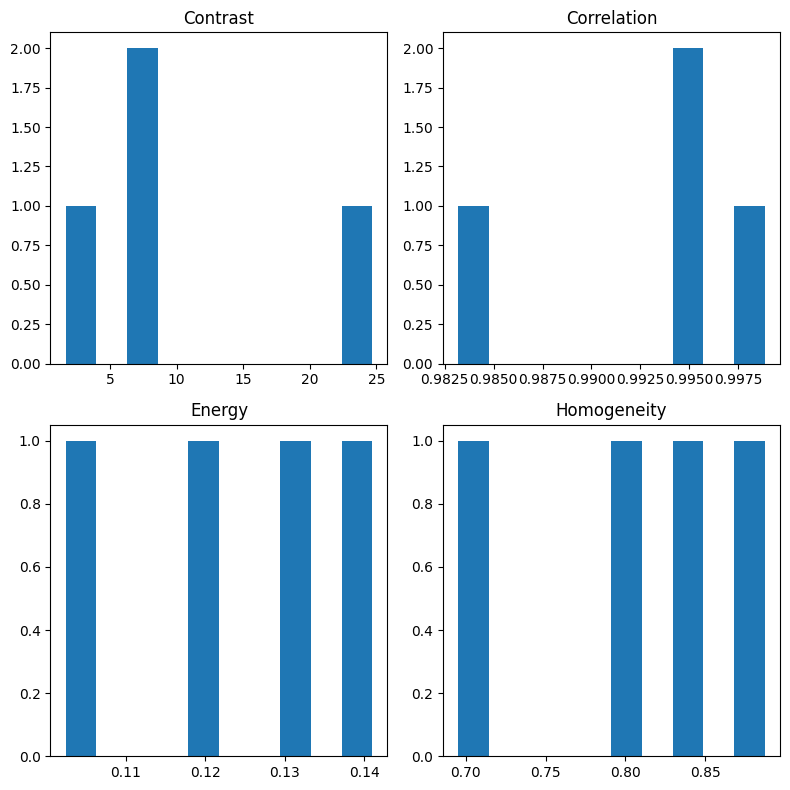

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import skimage
from skimage import data, io
from skimage.filters import sobel
from skimage.feature import greycomatrix, greycoprops
for image in image_dataset:
  # Load an image
  # Convert the image to grayscale
  image_gray=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
  #image_gray= np.expand_dims(image_gray, axis=2)
  # Compute the gradient of the image using the Sobel filter
  #gradient = sobel(image_gray)
  cv2_imshow(image_gray)
  # Compute the grey-level co-occurrence matrix (GLCM) of the gradient image
  glcm = greycomatrix(image_gray, [1, 2], [0, np.pi/2], levels=256,normed=True, symmetric=True)
  # Compute the contrast, correlation, energy, and homogeneity features of the GLCM
  contrast = graycoprops(glcm, 'contrast')
  correlation = graycoprops(glcm, 'correlation')
  energy = graycoprops(glcm, 'energy')
  homogeneity =graycoprops(glcm, 'homogeneity')
  print(contrast)
  # Plot the histograms of the features
  fig, ax = plt.subplots(2, 2, figsize=(8, 8))

  ax[0, 0].hist(contrast.ravel())
  ax[0, 0].set_title('Contrast')

  ax[0, 1].hist(correlation.ravel())
  ax[0, 1].set_title('Correlation')

  ax[1, 0].hist(energy.ravel())
  ax[1, 0].set_title('Energy')

  ax[1, 1].hist(homogeneity.ravel())
  ax[1, 1].set_title('Homogeneity')

  # for a in ax.ravel():
  #     a.set_xlim([0, 1])
  #     a.set_ylim([0, 5000])

  plt.tight_layout()
  plt.show()


#PART B
#VIDEO ANALYSIS

In [ ]:
from datetime import timedelta
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow

In [ ]:
SAVING_FRAMES_PER_SECOND = 25

In [ ]:
def format_timedelta(td):
    """Utility function to format timedelta objects in a cool way (e.g 00:00:20.05)
    omitting microseconds and retaining milliseconds"""
    result = str(td)
    try:
        result, ms = result.split(".")
    except ValueError:
        return (result + ".00").replace(":", "-")
    ms = int(ms)
    ms = round(ms / 1e4)
    return f"{result}.{ms:02}".replace(":", "-")


def get_saving_frames_durations(cap, saving_fps):
    """A function that returns the list of durations where to save the frames"""
    s = []
    # get the clip duration by dividing number of frames by the number of frames per second
    clip_duration = cap.get(cv2.CAP_PROP_FRAME_COUNT) / cap.get(cv2.CAP_PROP_FPS)
    # use np.arange() to make floating-point steps
    for i in np.arange(0, clip_duration, 1 / saving_fps):
        s.append(i)
    return s

In [ ]:
def main(video_file):
    filename, _ = os.path.splitext(video_file)
    filename += "-opencv"
    # make a folder by the name of the video file
    if not os.path.isdir(filename):
        os.mkdir(filename)
    # read the video file
    cap = cv2.VideoCapture(video_file)
    # get the FPS of the video
    fps = cap.get(cv2.CAP_PROP_FPS)
    # if the SAVING_FRAMES_PER_SECOND is above video FPS, then set it to FPS (as maximum)
    saving_frames_per_second = min(fps, SAVING_FRAMES_PER_SECOND)
    # get the list of duration spots to save
    saving_frames_durations = get_saving_frames_durations(cap, saving_frames_per_second)
    # start the loop
    count = 0
    while True:
        is_read, frame = cap.read()
        if not is_read:
            # break out of the loop if there are no frames to read
            break
        # get the duration by dividing the frame count by the FPS
        frame_duration = count / fps
        try:
            # get the earliest duration to save
            closest_duration = saving_frames_durations[0]
        except IndexError:
            # the list is empty, all duration frames were saved
            break
        if frame_duration >= closest_duration:
            # if closest duration is less than or equals the frame duration,
            # then save the frame
            frame_duration_formatted = format_timedelta(timedelta(seconds=frame_duration))
            cv2.imwrite(os.path.join(filename, f"frame{frame_duration_formatted}.jpg"), frame)
            # drop the duration spot from the list, since this duration spot is already saved
            try:
                saving_frames_durations.pop(0)
            except IndexError:
                pass
        # increment the frame count
        count += 1

In [ ]:
if __name__ == "__main__":
    import sys
    video_file = '/content/drive/MyDrive/FULL_MATCH_Chelsea_v_Manchester_City_Emirates_FA_Cup_Semi-Final_2020-21_from480s_to540s.mp4'
    main(video_file)

In [ ]:
lis=os.listdir('/content/drive/MyDrive/FULL_MATCH_Chelsea_v_Manchester_City_Emirates_FA_Cup_Semi-Final_2020-21_from480s_to540s-opencv')
len(lis)

1378

In [ ]:
from PIL import Image
image_directory = '/content/drive/MyDrive/FULL_MATCH_Chelsea_v_Manchester_City_Emirates_FA_Cup_Semi-Final_2020-21_from480s_to540s-opencv'
frame_dataset = []
images = os.listdir(image_directory)
for i, image_name in enumerate(images):    #Remember enumerate method adds a counter and returns the enumerate object
    if (image_name.split('.')[2] == 'jpg'):
        #print(image_directory+image_name)
        image = cv2.imread(image_directory+"/"+image_name)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (1280, 720))
        image = Image.fromarray(image)
        frame_dataset.append(np.array(image))
frame_dataset = np.array(frame_dataset)
frame_dataset.shape

(1378, 720, 1280, 3)

##CAMERA CHANGE

In [ ]:
difference=[]
for i in range(frame_dataset.shape[0]-1):
  difference.append(np.abs(frame_dataset[i+1])-np.abs(frame_dataset[i]))

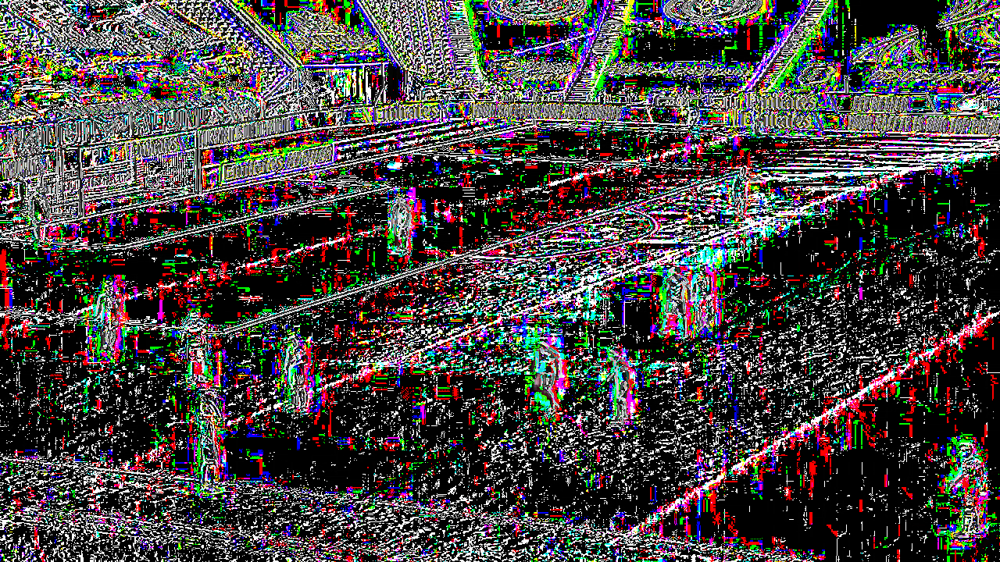

In [ ]:
cv2_imshow(difference[0])

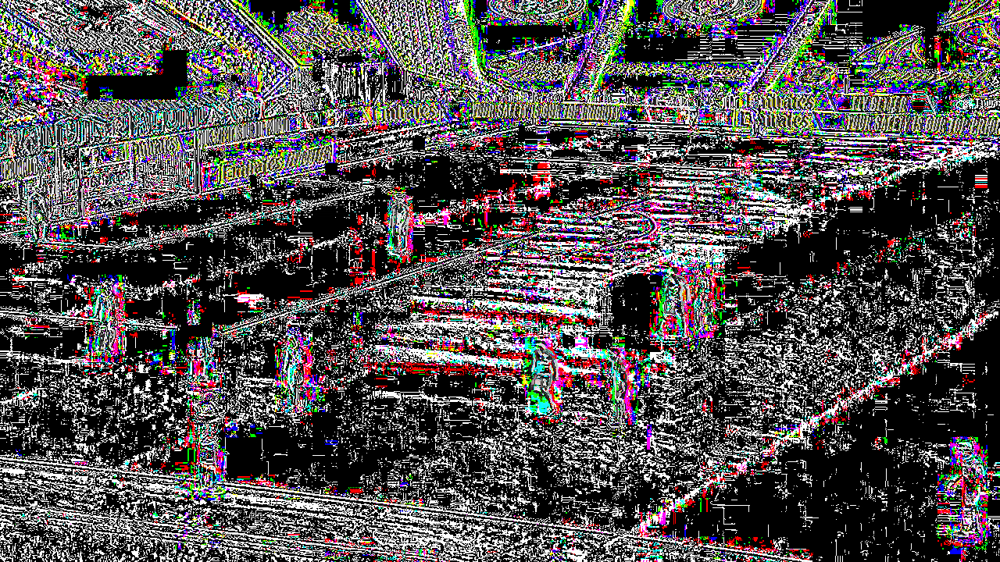

In [ ]:
cv2_imshow(difference[1])

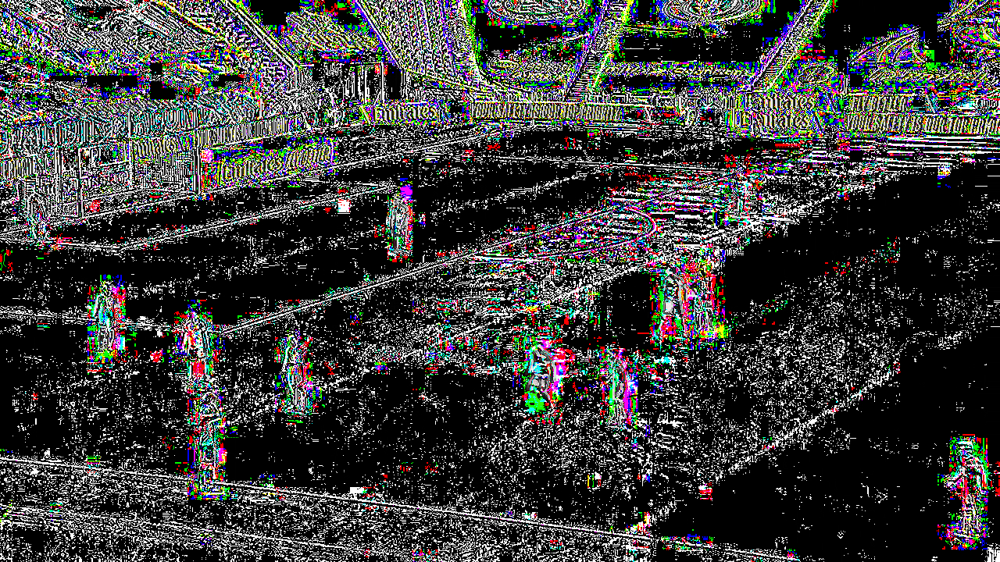

In [ ]:
cv2_imshow(difference[2])

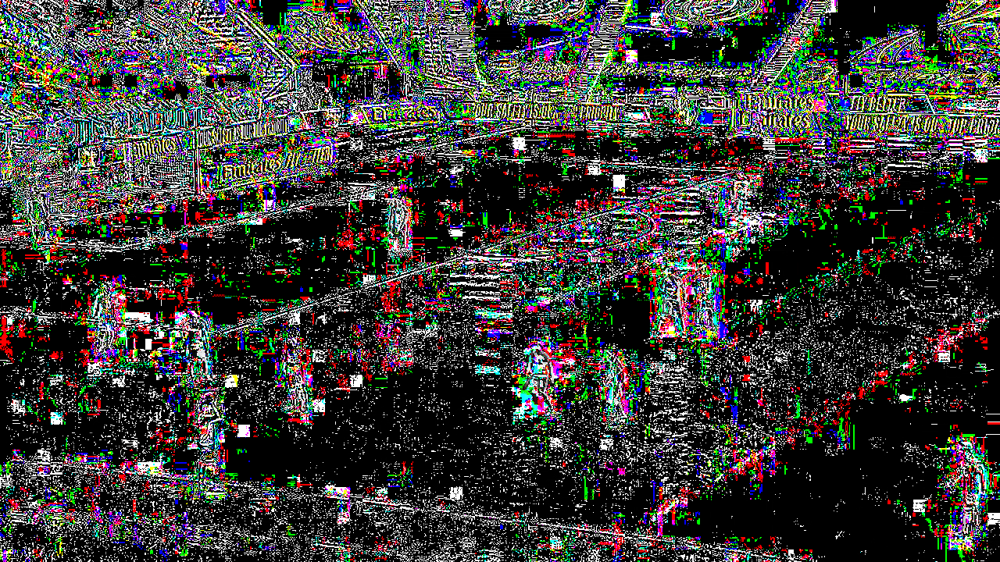

In [ ]:
cv2_imshow(difference[3])

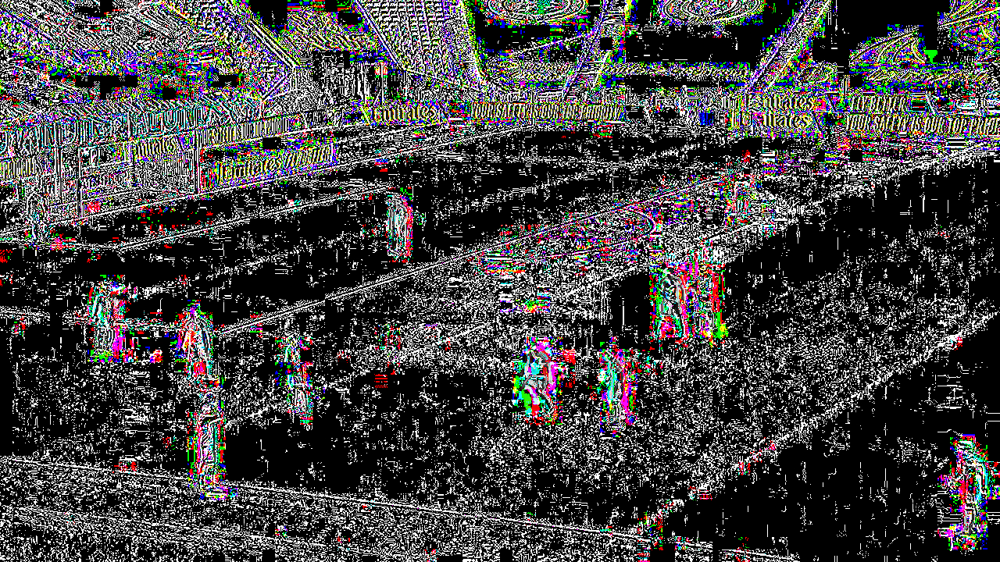

In [ ]:
cv2_imshow(difference[4])

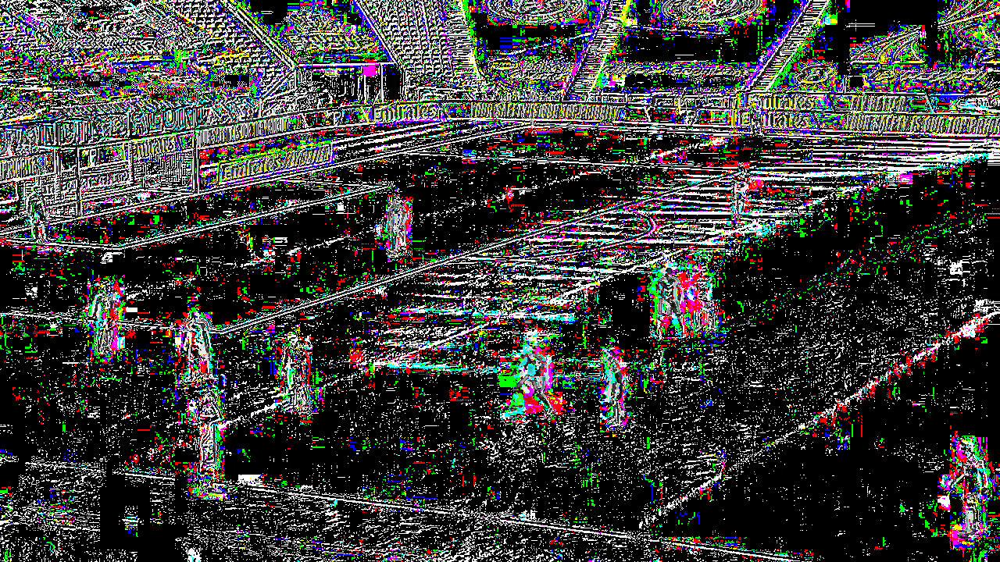

In [ ]:
cv2_imshow(difference[5])

In [ ]:
np.sum(difference[0])

188556339

In [ ]:
np.sum(difference[1])

223538436

In [ ]:
dif_sum=[]
for i in difference:
  dif_sum.append(np.sum(i))

In [ ]:
max(dif_sum)

448782087

In [ ]:
n=dif_sum.index(max(dif_sum))

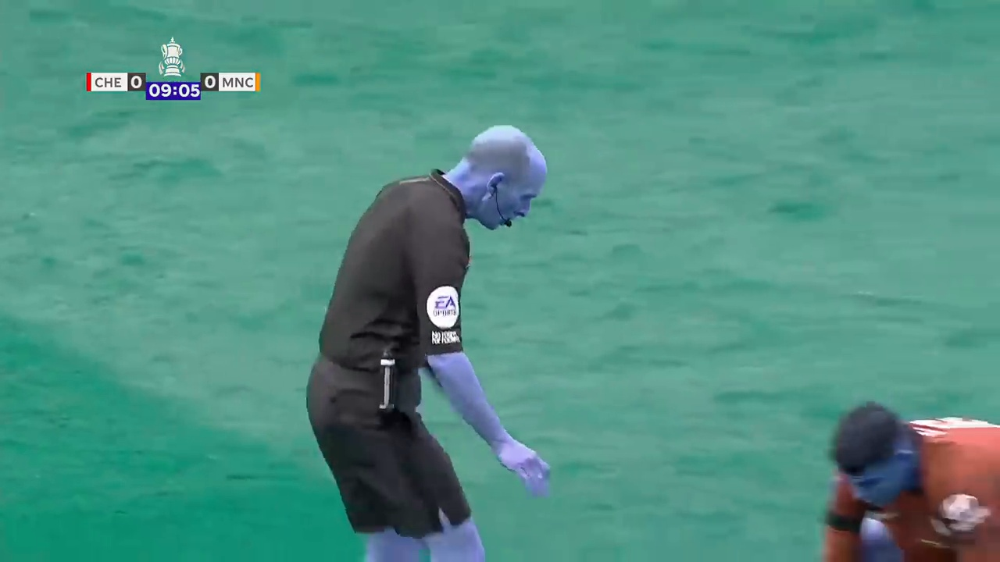

--------------------


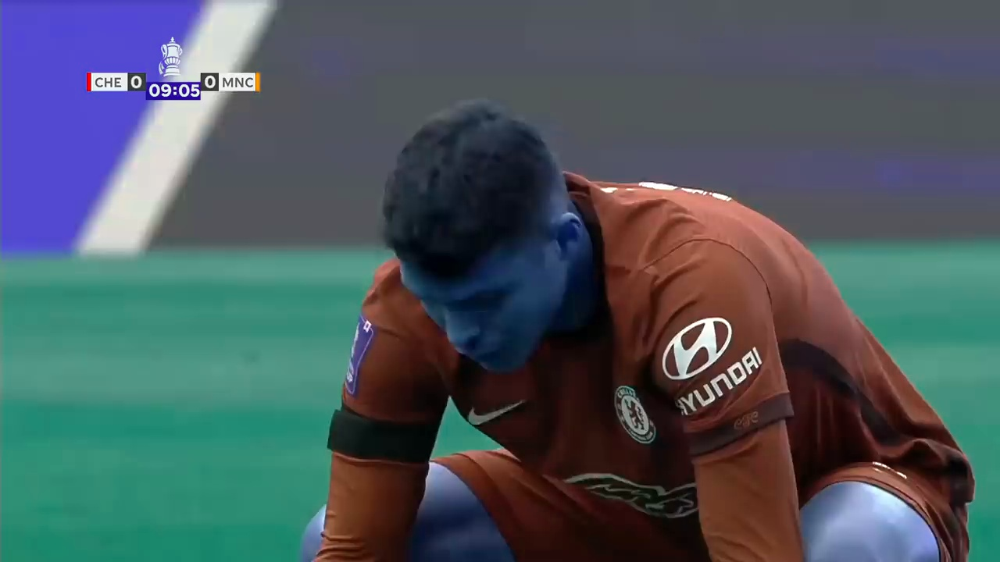

In [ ]:
cv2_imshow(frame_dataset[n])
print("--------------------")
cv2_imshow(frame_dataset[n+1])

###Plotting

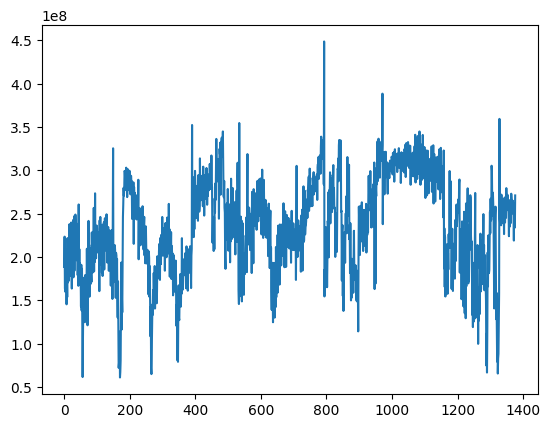

In [ ]:
import matplotlib.pyplot as plt
x=np.arange(len(dif_sum))
plt.plot(x,dif_sum)

Using OpenCV commands we were able to overlay the contours on the original image to show the segmented objects.

The contour number for an instance of the segmented image :  0
The contour number for an instance of the segmented image :  1
The contour number for an instance of the segmented image :  2
The contour number for an instance of the segmented image :  3
The contour number for an instance of the segmented image :  4
The contour number for an instance of the segmented image :  5
The contour number for an instance of the segmented image :  6
The contour number for an instance of the segmented image :  7
The contour number for an instance of the segmented image :  8
The contour number for an instance of the segmented image :  9
The contour number for an instance of the segmented image :  10
The contour number for an instance of the segmented image :  11
The contour number for an instance of the segmented image :  12
The contour number for an instance of the segmented image :  13
The contour number for an instance of the segmented image :  14
The contour number for an instance of the segmente

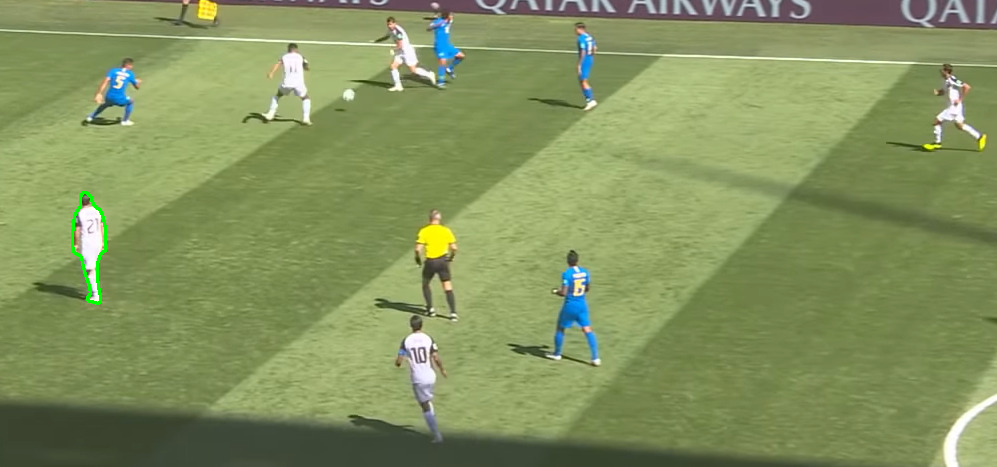

Instance Number:  1


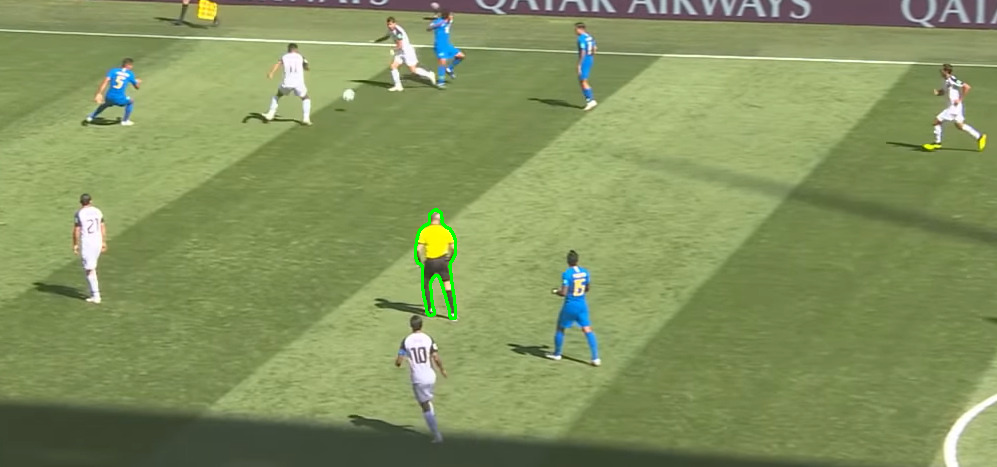

Instance Number:  2


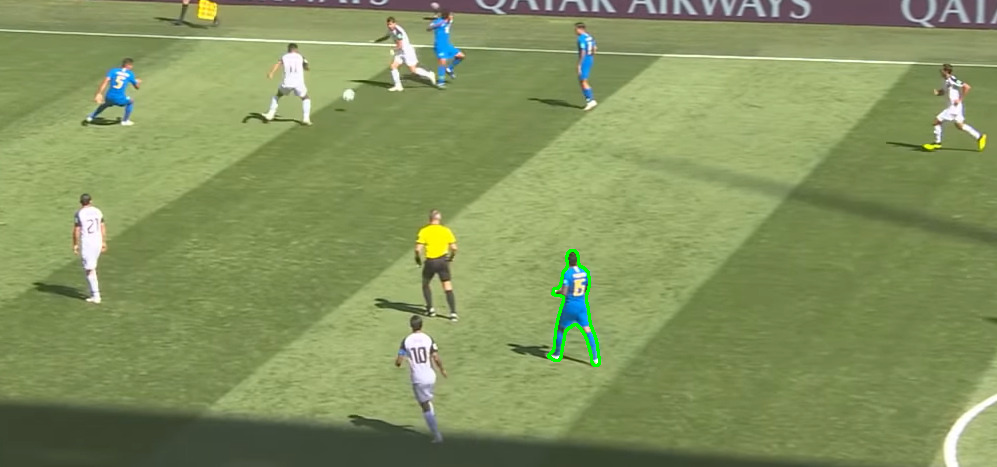

Instance Number:  3


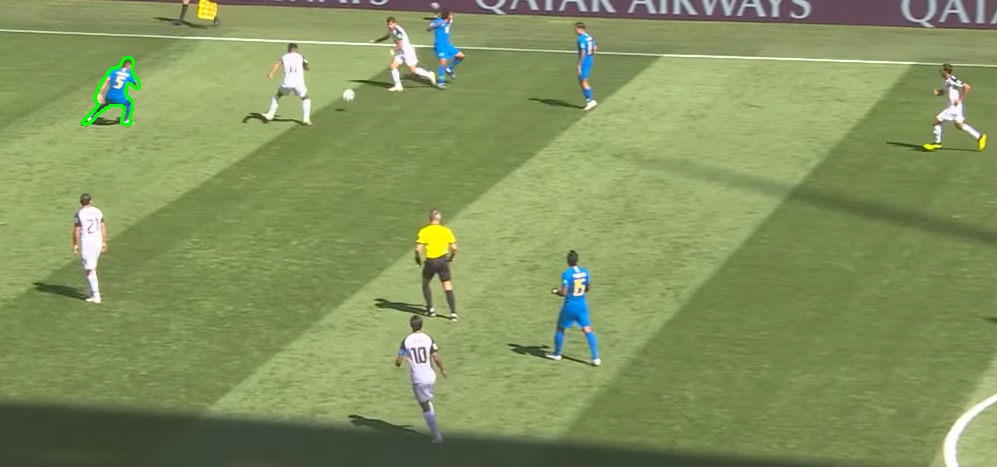

Instance Number:  4


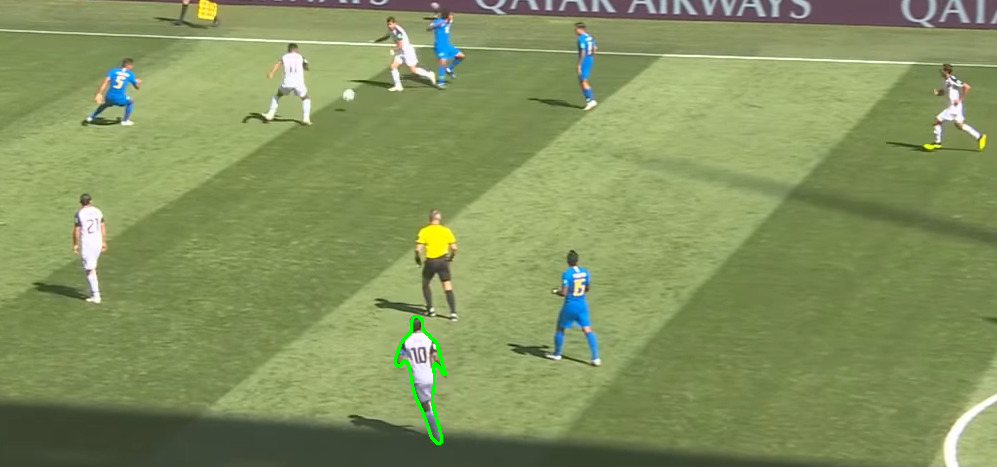

Instance Number:  5


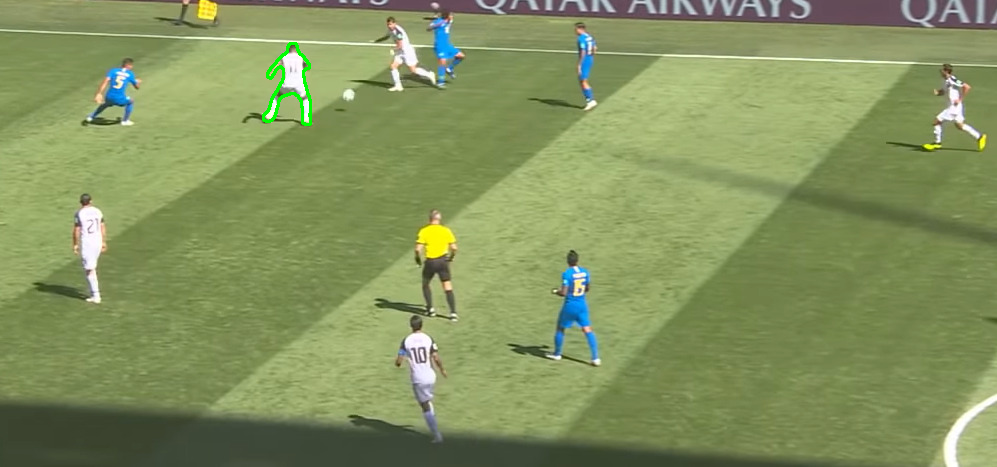

Instance Number:  6


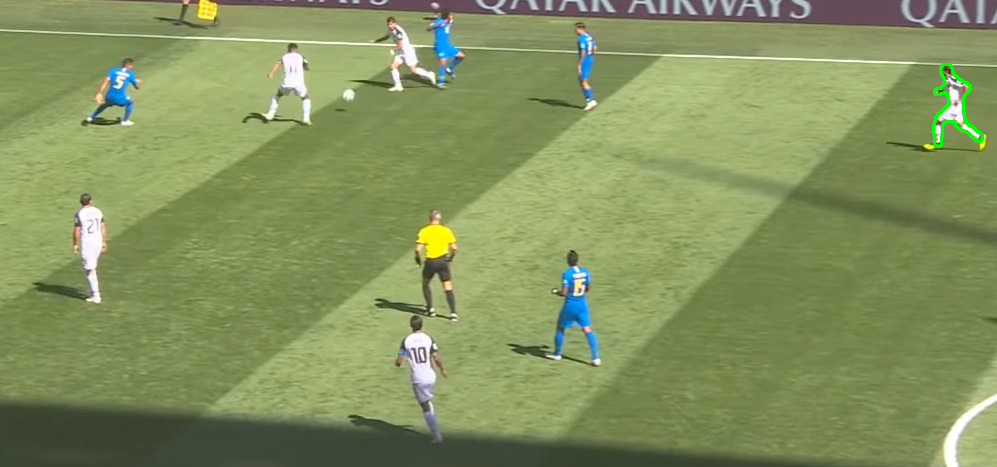

Instance Number:  7


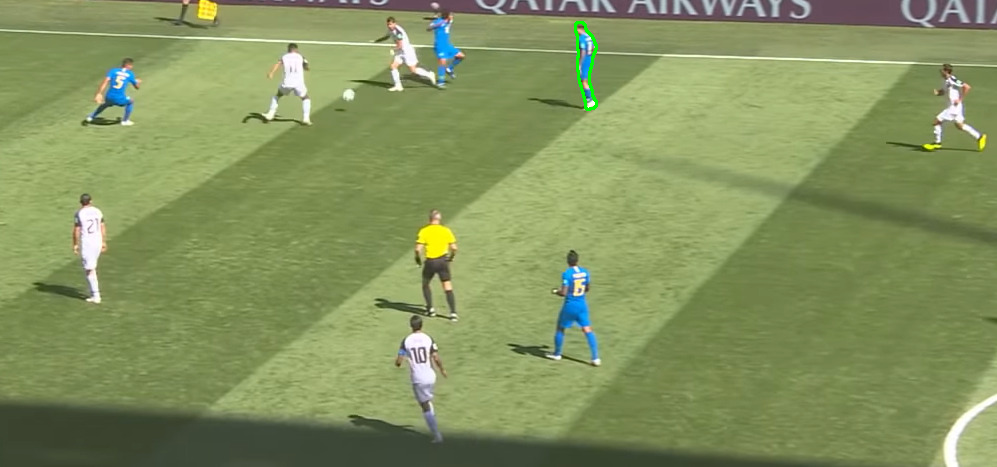

Instance Number:  8


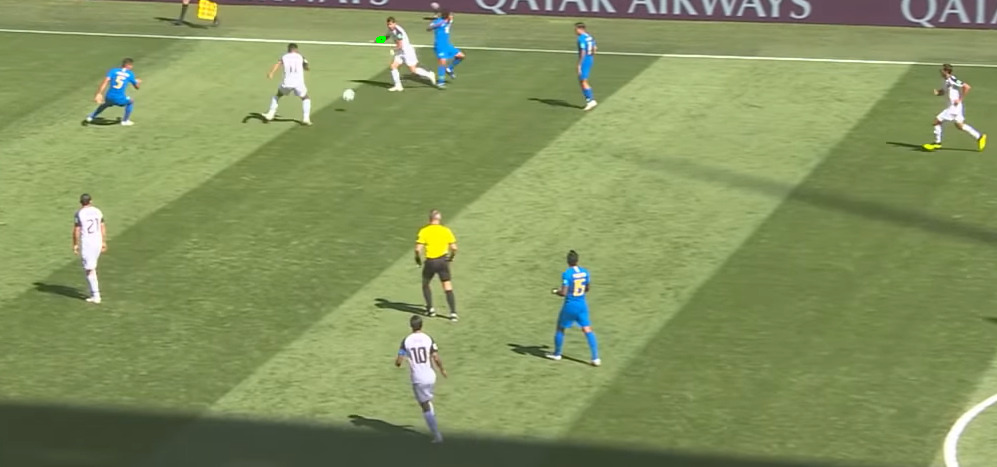

Instance Number:  9


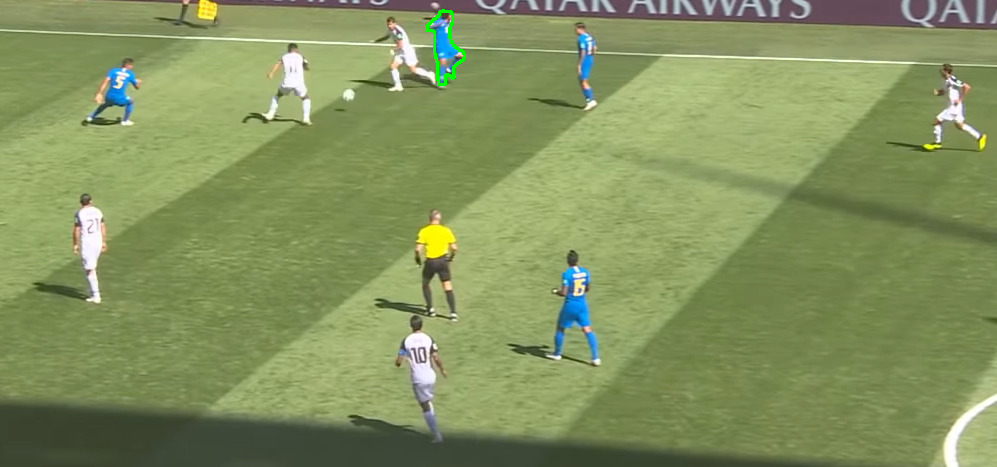

Instance Number:  10


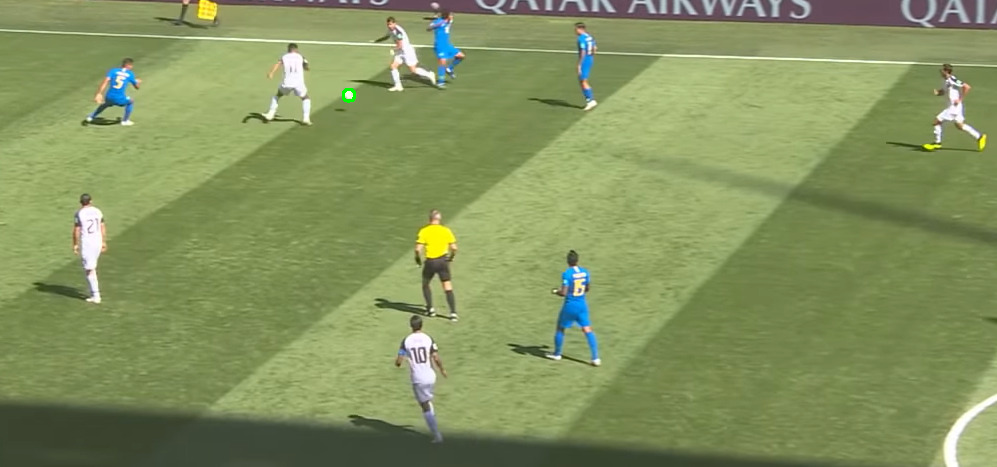

Instance Number:  11


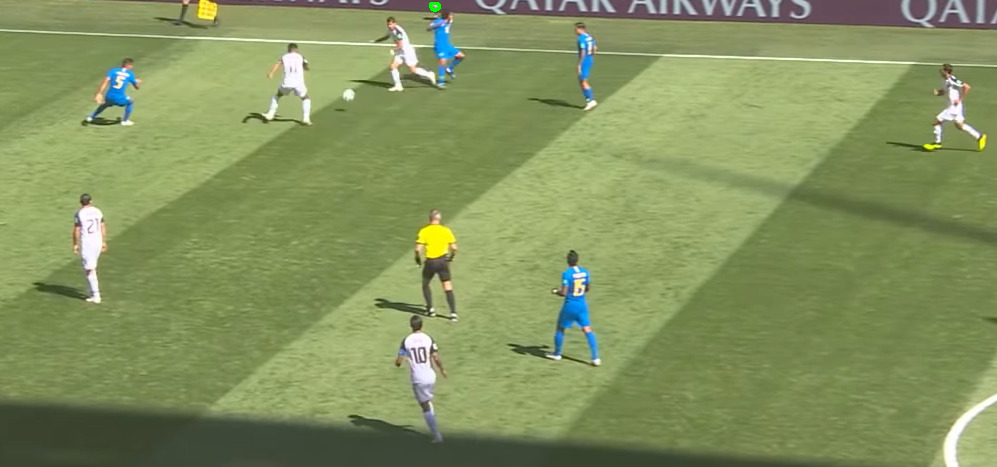

Instance Number:  12


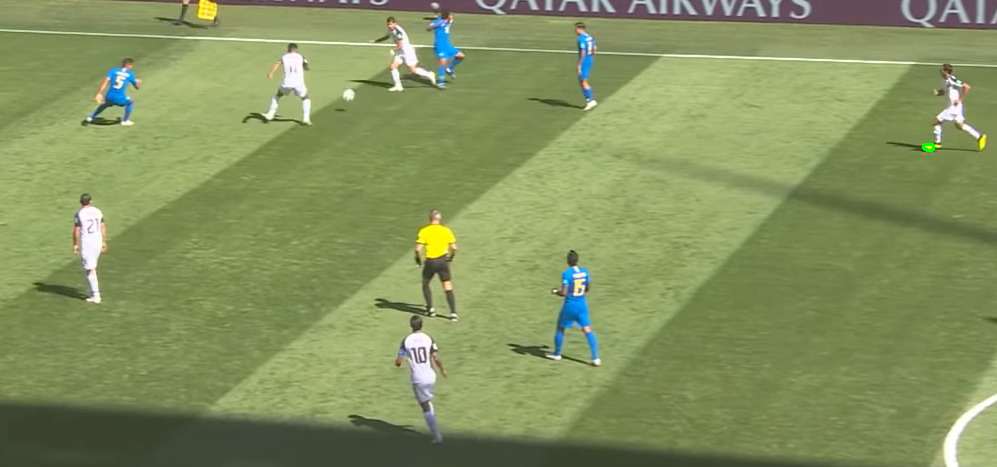

Instance Number:  13


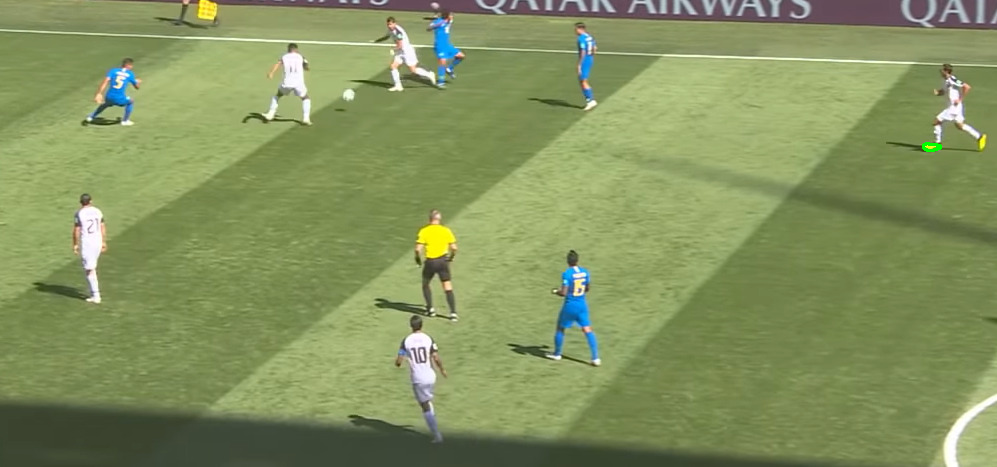

Instance Number:  14


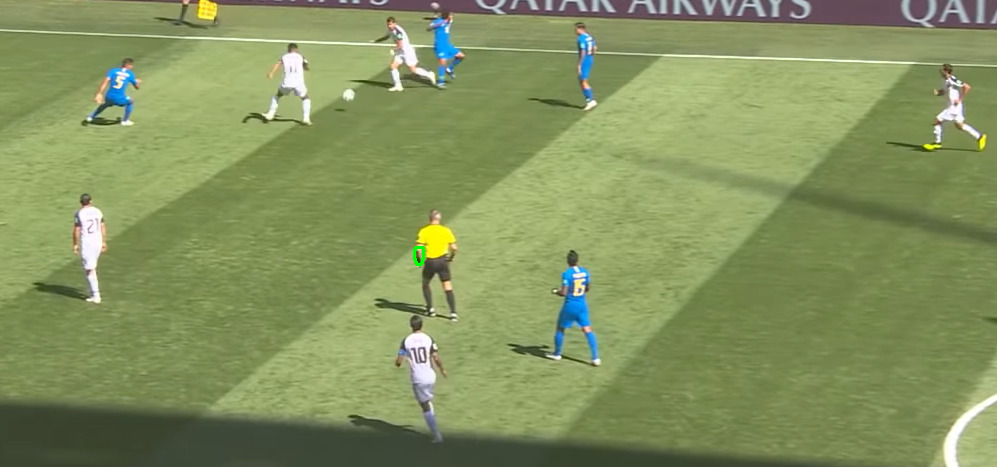

Instance Number:  15


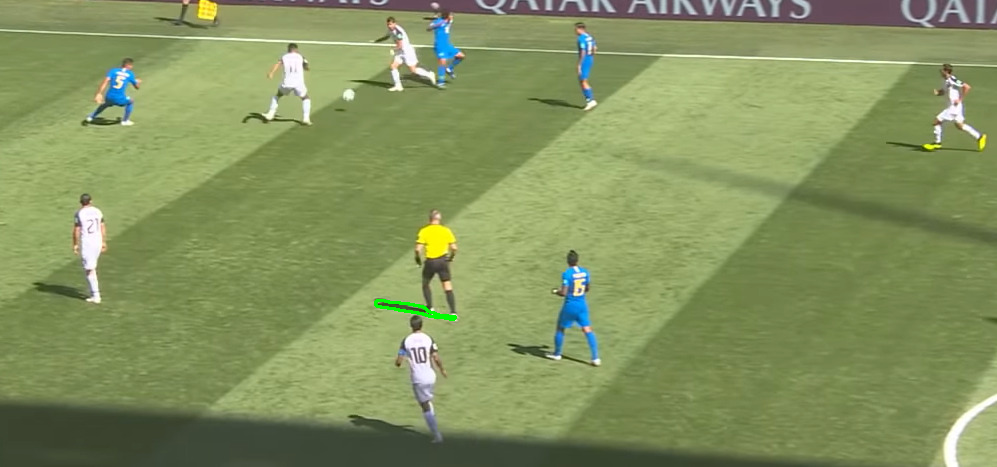

Instance Number:  16


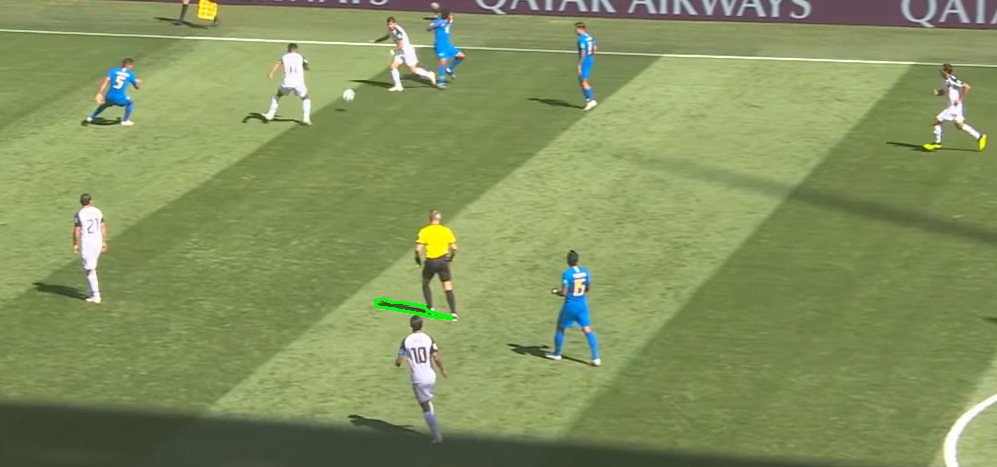

Instance Number:  17


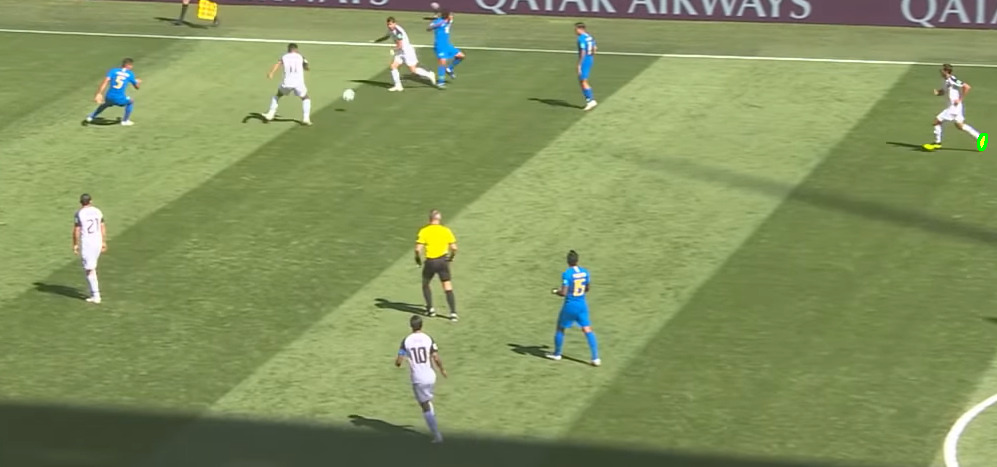

Instance Number:  18


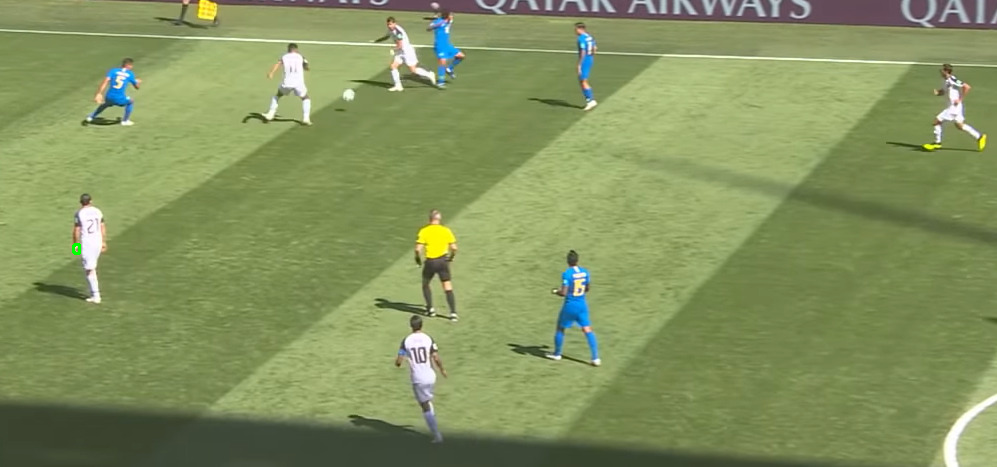

Instance Number:  19


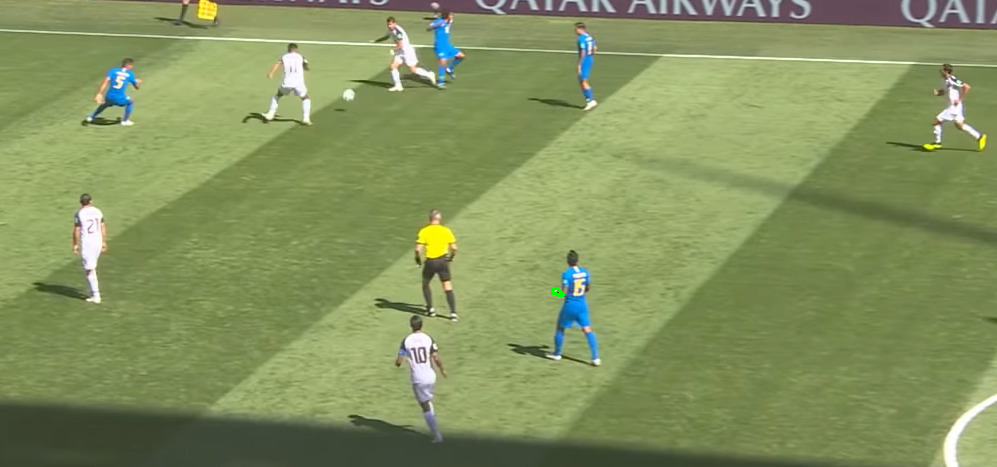

Instance Number:  20


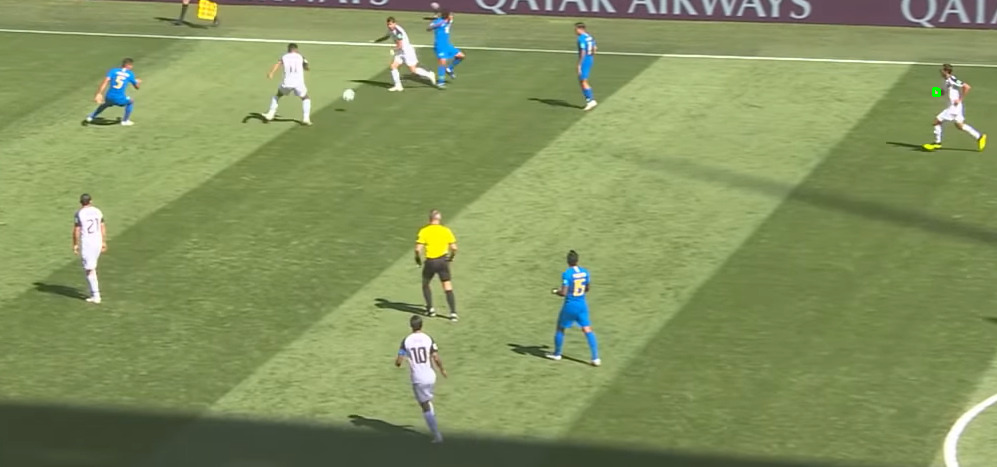

Instance Number:  21


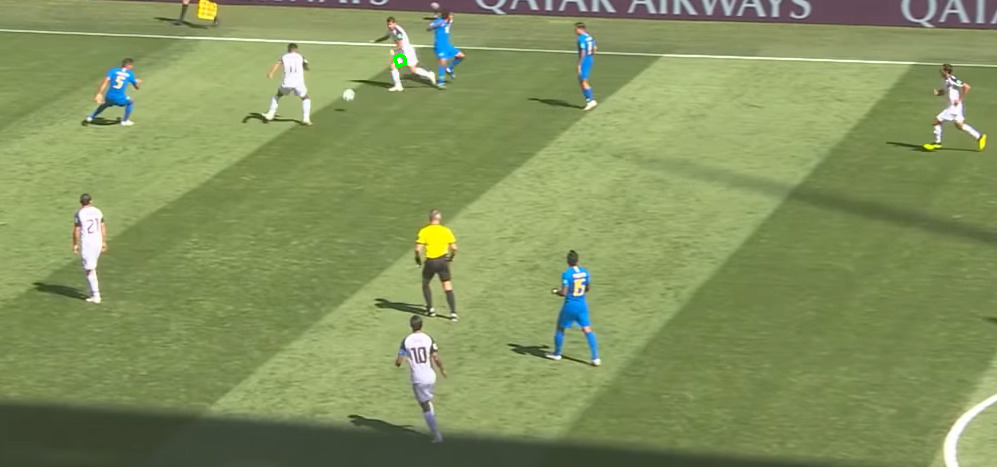

Instance Number:  22


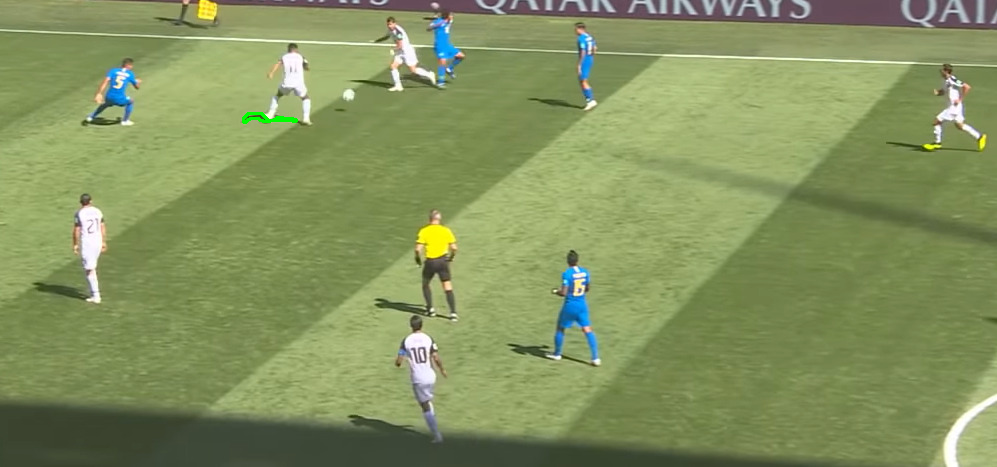

Instance Number:  23


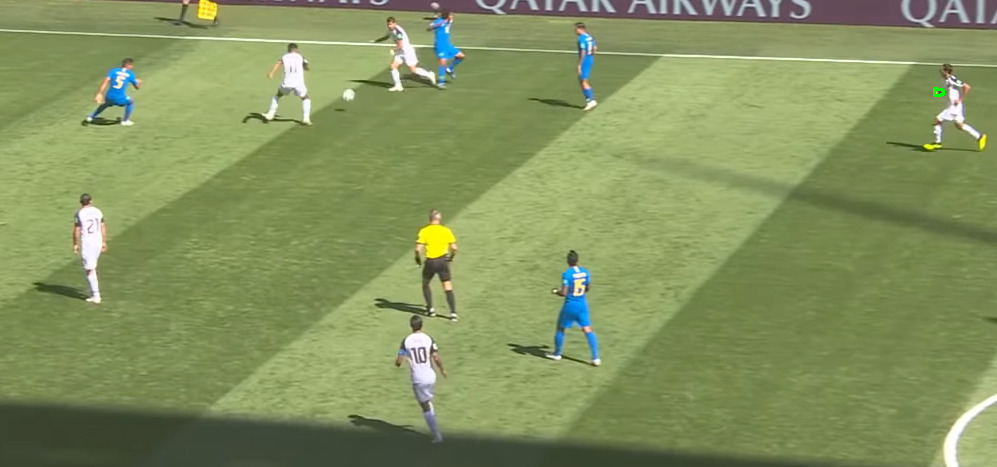

In [ ]:
i = 0
contours = get_countours(image, False)
for contour in contours:
    print('Instance', i)
    i = i + 1
    image_with_overlaid_predictions = image.copy()
    cv2_imshow(cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255, 0), 2))

def show_contour_at_i(image, contours, i):
  countour = contours[i]
  image_with_overlaid_predictions = image.copy()
  cv2_imshow(cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255, 0), 2))

Getting the mask for our objects of interest to run boundary tracing algorithms on them.

Player


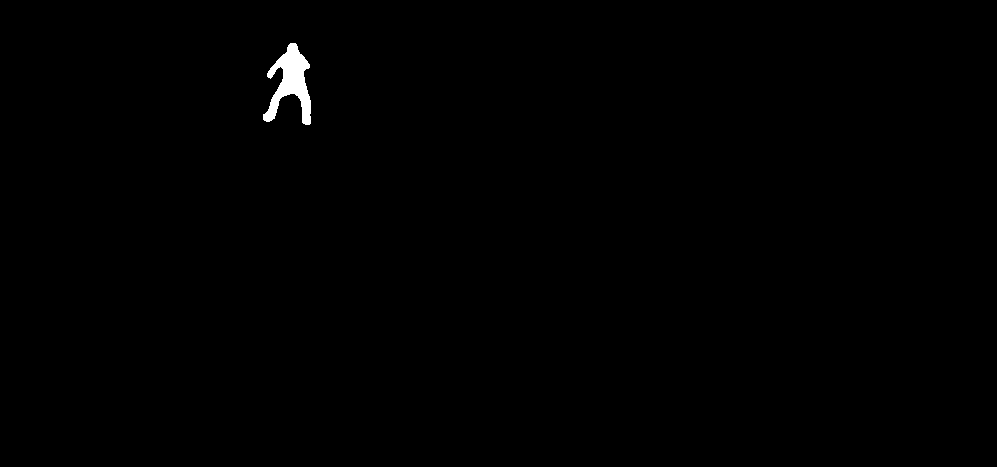

In [ ]:
def get_mask_at_i(image, i):
  # Get the binary mask.
  segment = numpy.array(predictor(image)['instances'].pred_masks[i].to("cpu")).astype(numpy.uint8)
  h, w = segment.shape
  mask = numpy.zeros((h, w), dtype=numpy.uint8) + segment

  for i in range(h):
    for j in range(w):
      if mask[i][j] == 1:
        mask[i][j] = 255

  return mask

print('Player')
cv2_imshow(get_mask_at_i(image, 5))

mask = get_mask_at_i(image, 5)

Extract boundaries (If the mask is A, Boundary extraction : A - (A (-) S), where S is a standard structural element.

boundaries


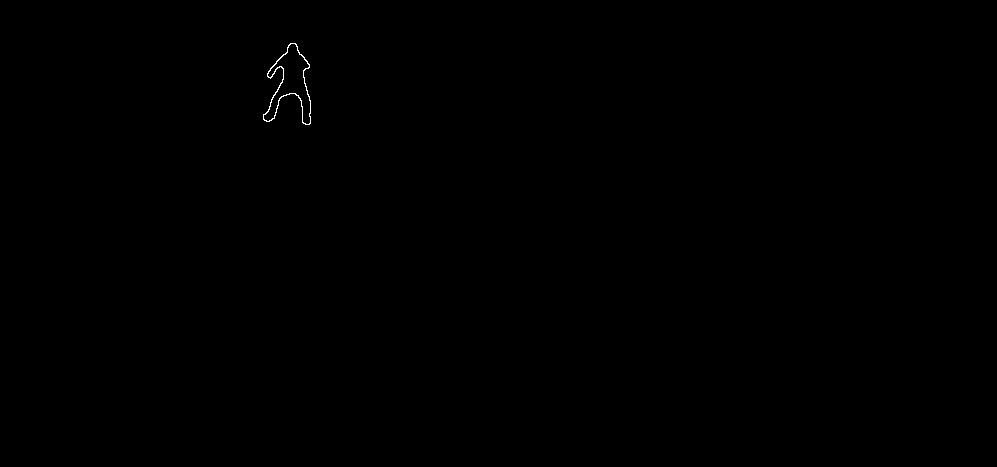

In [ ]:
se = numpy.ones((3, 3), dtype=numpy.uint8)
eroded_mask = cv2.erode(mask, se)

boundaries = mask - eroded_mask
print('boundaries')
cv2_imshow(boundaries)

Freeman Chaincode (n-8)

In [ ]:
def get_start_point(image):
    start_point = [0, 0]
    for j in range(image.shape[1]):
      for i in range(image.shape[0]):
        if (image[i][j] == 255):
          start_point[0] = i
          start_point[1] = j
          return start_point

print('Starting point:', get_start_point(mask))
start_point = get_start_point(mask)

Starting point: [114, 263]


In [ ]:
def is_in_range(image, point):
    if point[0] >= 0 and point[0] < image.shape[0] and point[1] >= 0 and point[1] < image.shape[1]:
      return True
    return False

def chain_code_8n(image, start_point):
  s = ""
  visited = list()

  prev_point = [-1, -1]
  curr_point = start_point

  while curr_point in visited and prev_point[0] != curr_point[0] or prev_point[1] != curr_point[1]:
    prev_point = curr_point

    if (is_in_range(image, [prev_point[0]+1, prev_point[1]]) and image[curr_point[0]+1][curr_point[1]] == 255 and not [prev_point[0]+1, prev_point[1]] in visited):
      curr_point = [curr_point[0]+1, curr_point[1]]
      s += '0'

    elif (is_in_range(image,  [prev_point[0]+1, prev_point[1]+1]) and image[curr_point[0]+1][curr_point[1]+1] == 255 and not [prev_point[0]+1, prev_point[1]+1] in visited):
      curr_point = [curr_point[0]+1, curr_point[1]+1]
      s += '7'

    elif (is_in_range(image,  [prev_point[0], prev_point[1]+1]) and image[curr_point[0]][curr_point[1]+1] == 255 and not [prev_point[0], prev_point[1]+1] in visited):
      curr_point = [curr_point[0], curr_point[1]+1]
      s += '6'

    elif (is_in_range(image,  [prev_point[0]-1, prev_point[1]+1]) and image[curr_point[0]-1][curr_point[1]+1] == 255 and not [prev_point[0]-1, prev_point[1]+1] in visited):
      curr_point = [curr_point[0]-1, curr_point[1]+1]
      s += '5'

    elif (is_in_range(image,  [prev_point[0]-1, prev_point[1]]) and image[curr_point[0]-1][curr_point[1]] == 255 and not [prev_point[0]-1, prev_point[1]] in visited):
      curr_point = [curr_point[0]-1, curr_point[1]]
      s += '4'

    elif (is_in_range(image,  [prev_point[0]-1, prev_point[1]-1]) and image[curr_point[0]-1][curr_point[1]-1] == 255 and not [prev_point[0]-1, prev_point[1]-1] in visited):
      curr_point = [curr_point[0]-1, curr_point[1]-1]
      s += '3'

    elif (is_in_range(image,  [prev_point[0], prev_point[1]-1]) and image[curr_point[0]][curr_point[1]-1] == 255 and not [prev_point[0], prev_point[1]-1] in visited):
      curr_point = [curr_point[0], curr_point[1]-1]
      s += '2'

    elif (is_in_range(image,  [prev_point[0]+1, prev_point[1]-1]) and image[curr_point[0]+1][curr_point[1]-1] == 255 and not [prev_point[0]+1, prev_point[1]-1] in visited):
      curr_point = [curr_point[0]+1, curr_point[1]-1]
      s += '1'

    visited.append(curr_point)

  return s

print('chain code of mask : ', chain_code_8n(boundaries, get_start_point(boundaries)))
print('boundary length : ', len(chain_code_8n(boundaries, get_start_point(boundaries))))

chain code of mask :  0000076766656556445445444544544445455565665665666677670770700000700000000000000076766665444444430
boundary length :  97


In [ ]:
# Performing the same algorithm for several (5) images and comparing the chain code and boundary length (aka the order).

image_paths = ['/content/drive/MyDrive/Football_Data/001.jpeg', '/content/drive/MyDrive/Football_Data/004.jpeg', '/content/drive/MyDrive/Football_Data/005.jpeg']
chain_codes = []

for path in image_paths:
  print(path)
  _image = cv2.imread(path)
  cv2_imshow(_image)

  panoptic_and_instance_segmentation(_image)

  get_countours(_image, True)
  contour_id = int(input('Enter countour ID'))

  _mask = get_mask_at_i(_image, contour_id)

  se = numpy.ones((3, 3), dtype=numpy.uint8)
  _eroded_mask = cv2.erode(_mask, se)

  _boundaries = _mask - _eroded_mask

  print(path)
  print('boundaries')
  cv2_imshow(_boundaries)


  print('chain code of mask : ', chain_code_8n(_boundaries, get_start_point(_boundaries)))
  print('boundary length : ', len(chain_code_8n(_boundaries, get_start_point(_boundaries))))

  chain_codes.append(chain_code_8n(_boundaries, get_start_point(_boundaries)))

i = 0
for path in image_paths:
  print(path)
  print('chain code : ', chain_codes[i])
  print('boundary length : ', len(chain_codes[i]))
  i += 1


In [ ]:
i = 0
for path in image_paths:
  print(path)
  print('chain code : ', chain_codes[i])
  print('boundary length : ', len(chain_codes[i]))
  i += 1


/content/drive/MyDrive/Football_Data/001.jpeg
chain code :  000000000000700707677700000000000000000000000700000070007000070000070776656544430
boundary length :  81
/content/drive/MyDrive/Football_Data/004.jpeg
chain code :  07666666554444444444444454566666656767766770700770707770707767666544430
boundary length :  71
/content/drive/MyDrive/Football_Data/005.jpeg
chain code :  0700000000000000000070000007000000007000000700000700000000007000070767667777076666675666444430
boundary length :  94
